In [25]:
import numpy as np
import pandas as pd
from sklearn import metrics
import sklearn.cluster as clust
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

import warnings
warnings.filterwarnings('ignore')

In [2]:
def read_data(mesh_num, segment_num=0):
    mesh = []
    polygons = []
    data = pd.read_csv(f'data/off/{mesh_num}.off')
    vertex_count, face_count, edge_count = map(int, data.values[0][0].split())
    
    for i in range(1, vertex_count + 1):
        parsed_row = list(map(float, data.values[i][0].split()))
        mesh.append(parsed_row)
        
    for i in range(vertex_count + 1, face_count + vertex_count + 1):
        parsed_row = list(map(int, data.values[i][0][1:].split()))
        polygons.append(parsed_row)
        
    polygon_labels = list(map(int, open(f'data/seg/{mesh_num}_{segment_num}.seg').readlines()))
    vertex_labels = {i:[] for i in range(len(mesh))}
    
    for i, polygon in enumerate(polygons):
        for vertex in polygon:
            vertex_labels[vertex].append(polygon_labels[i])

    for i in range(len(vertex_labels)):
        vertex_labels[i] = np.bincount(vertex_labels[i]).argmax()

    return np.array(mesh), np.array(list(vertex_labels.values())) 

In [11]:
def eval_scores(mesh, data_labels, pred_labels):
    cluster_metrics = [metrics.adjusted_rand_score,
                       metrics.adjusted_mutual_info_score,
                       metrics.homogeneity_score,
                       metrics.completeness_score,
                       metrics.v_measure_score,
                       metrics.fowlkes_mallows_score]

    scores = []
    for metric in cluster_metrics:
        scores.append(metric(data_labels, pred_labels))
        if metric.__name__ == 'adjusted_mutual_info_score':
            print(f'{metric.__name__}:\t {scores[-1]}')
        else:
            print(f'{metric.__name__}:\t\t {scores[-1]}')

    scores.append(metrics.silhouette_score(mesh, pred_labels, metric='euclidean'))
    print(f'silhouette_score:\t\t {scores[-1]}')
    
    avg_score = np.average(scores)
    print(f'\nAverage score:\t\t\t {avg_score}')
    print('-' * 100)
    
    return avg_score

In [12]:
def plot_data(mesh, data_labels, pred_labels):
    plot_properties = [(data_labels, 'Dataset labels'), (pred_labels, 'Clustered data')]
    
    ## 2D plots
    fig, plots = plt.subplots(1, 2, figsize=(17,6))
    for i, (labl, title) in enumerate(plot_properties):
        plots[i].scatter(mesh[:, 0], mesh[:, 1], c=labl)
        plots[i].set_title(title)
        plots[i].set_xlabel('X')
        plots[i].set_ylabel('Y')

    ## 3D plots
    fig = plt.figure(figsize=(20, 8))
    for i, (labl, title) in enumerate(plot_properties, start=1):
        ax = fig.add_subplot(1, 2, i, projection='3d')
        ax.scatter(mesh[:, 0], mesh[:, 1], mesh[:, 2], c=labl)
        ax.title.set_text(title)
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')

    plt.show()

### Reading the data

In [5]:
# pick 1 mesh from each category
models = [(5, 'Human'), (35, 'Cup'), (50, 'Glasses'), (66, 'Airplane'), (90, 'Ant'), 
          (120, 'Chair'), (136, 'Octopus'), (150, 'Table'), (169, 'Teddy'), (183, 'Hand'), 
          (202, 'Plier'), (222, 'Fish'), (242, 'Bird'), (284, 'Armadillo'), (301, 'Bust'), 
          (330, 'Mech'), (358, 'Bearing'), (363, 'Vase'), (387, 'Fourleg')]

meshes, data_labels = [], []
for mesh_num, _ in models:
    mesh, data_label = read_data(mesh_num=mesh_num)
    meshes.append(mesh)
    data_labels.append(data_label)

### K-Means


Category: Human
--------------------
CPU times: user 2.16 s, sys: 42.3 ms, total: 2.21 s
Wall time: 1.13 s


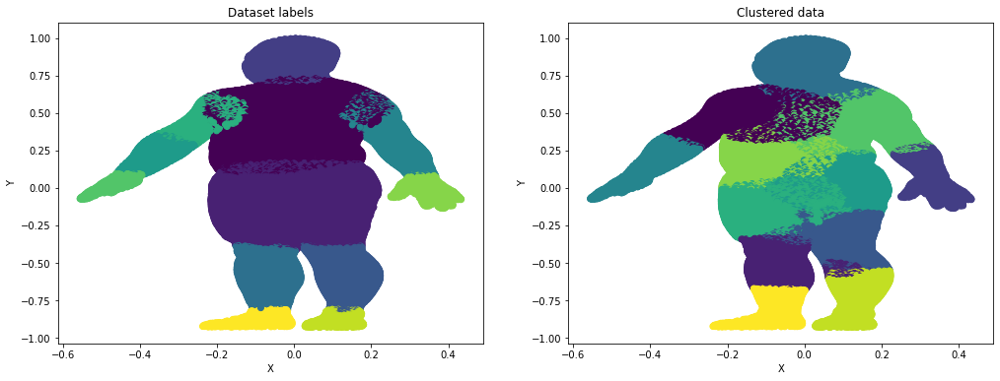

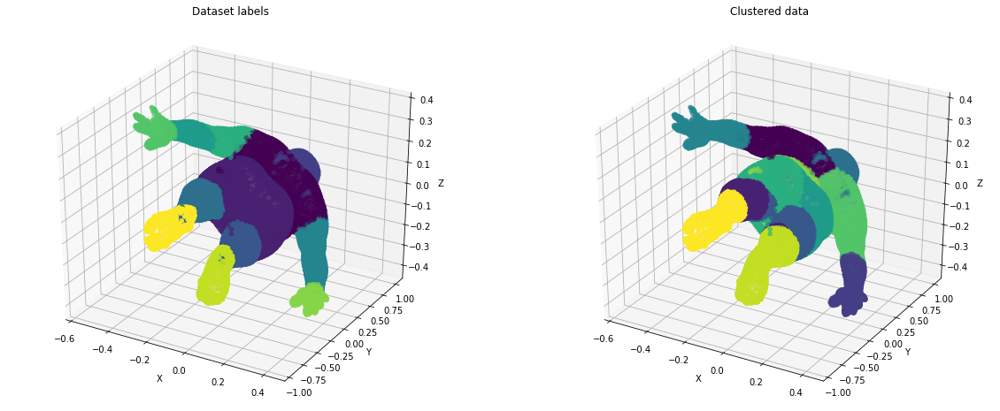

adjusted_rand_score:		 0.4019281447251817
adjusted_mutual_info_score:	 0.6579381372592306
homogeneity_score:		 0.7356020382982346
completeness_score:		 0.6584932666044162
v_measure_score:		 0.6949151717481697
fowlkes_mallows_score:		 0.4795063864942817
silhouette_score:		 0.3818558320547315

Average score:			 0.5728912824548923
----------------------------------------------------------------------------------------------------

Category: Cup
--------------------
CPU times: user 399 ms, sys: 7.88 ms, total: 406 ms
Wall time: 205 ms


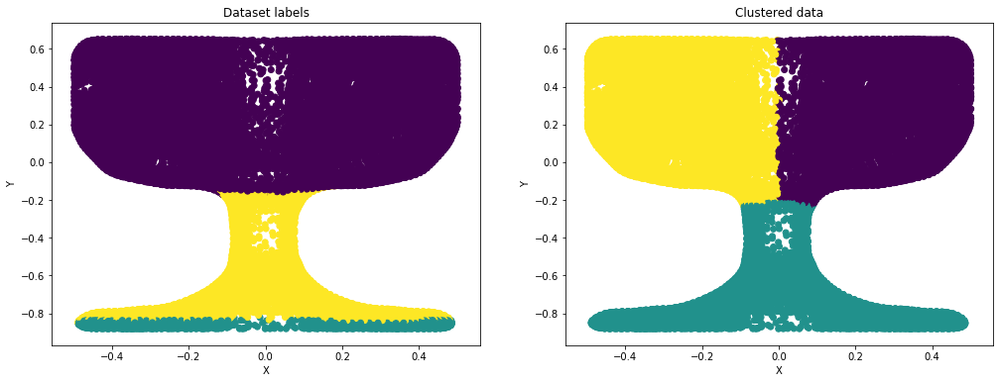

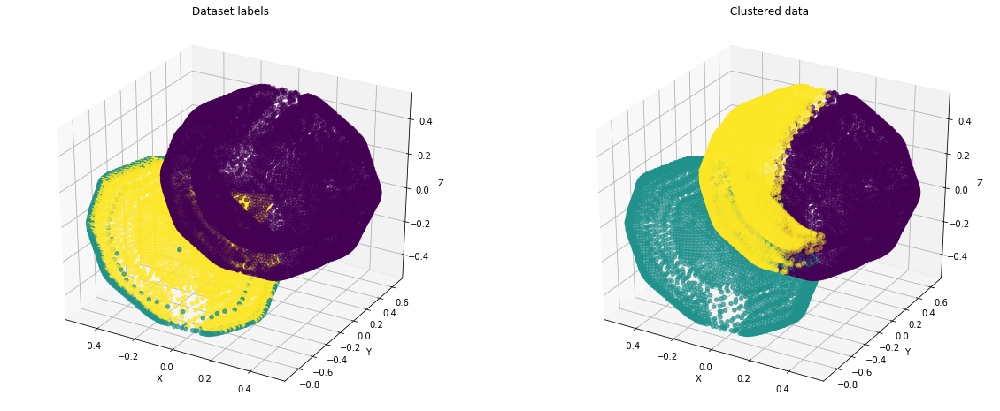

adjusted_rand_score:		 0.42042101227478795
adjusted_mutual_info_score:	 0.4820180787452477
homogeneity_score:		 0.7150342762814165
completeness_score:		 0.4820811468663593
v_measure_score:		 0.5758919103257616
fowlkes_mallows_score:		 0.6923063196243537
silhouette_score:		 0.35685344685298426

Average score:			 0.5320865987101302
----------------------------------------------------------------------------------------------------

Category: Glasses
--------------------
CPU times: user 150 ms, sys: 3.14 ms, total: 154 ms
Wall time: 77.8 ms


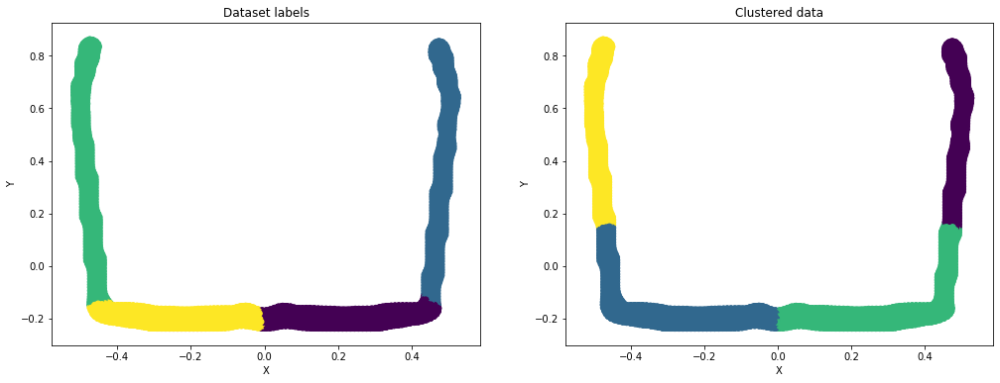

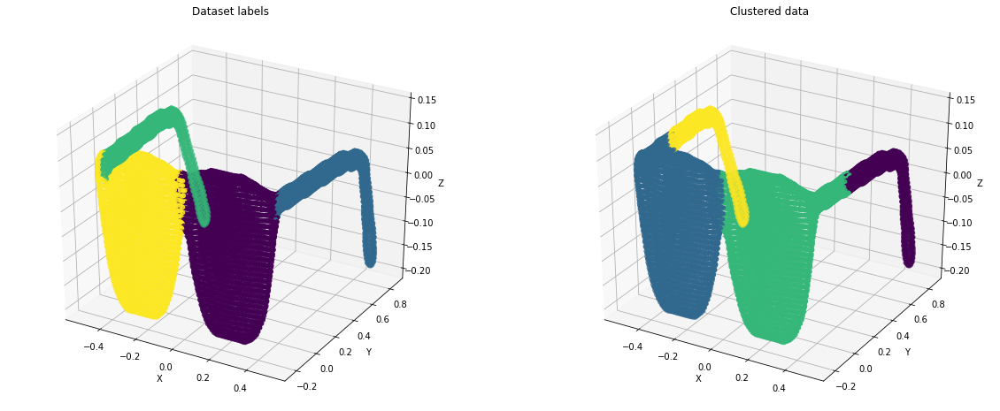

adjusted_rand_score:		 0.7960735300616645
adjusted_mutual_info_score:	 0.7819707421965547
homogeneity_score:		 0.7820701351076015
completeness_score:		 0.8324096357822679
v_measure_score:		 0.8064550922955048
fowlkes_mallows_score:		 0.8578550991069429
silhouette_score:		 0.553977425021748

Average score:			 0.7729730942246121
----------------------------------------------------------------------------------------------------

Category: Airplane
--------------------
CPU times: user 473 ms, sys: 9.37 ms, total: 483 ms
Wall time: 244 ms


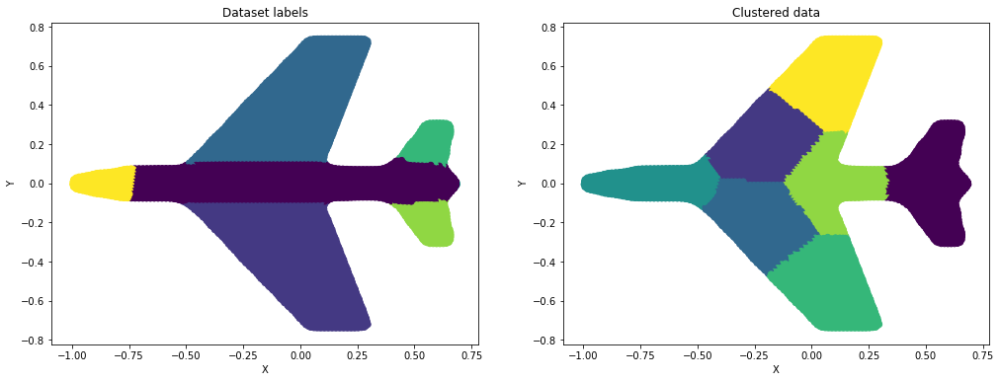

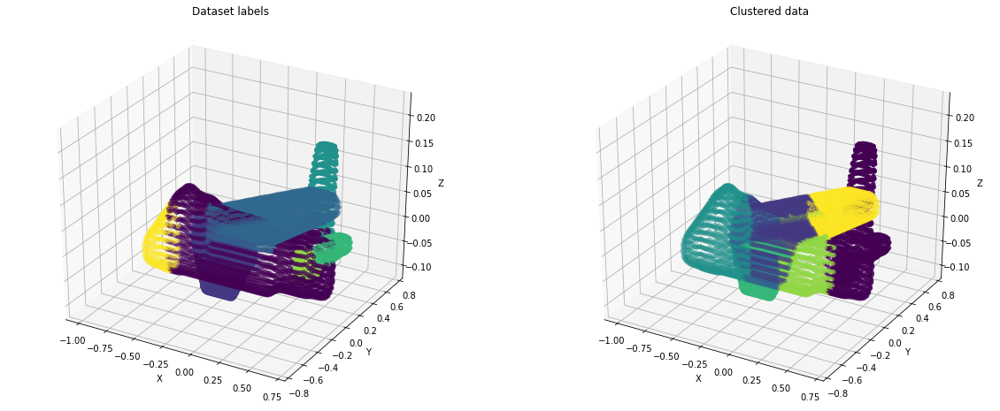

adjusted_rand_score:		 0.36355353873107427
adjusted_mutual_info_score:	 0.5100925857719587
homogeneity_score:		 0.6179196549491203
completeness_score:		 0.5106834235745302
v_measure_score:		 0.5592069185141717
fowlkes_mallows_score:		 0.49305740537342424
silhouette_score:		 0.44212170582915855

Average score:			 0.4995193189633483
----------------------------------------------------------------------------------------------------

Category: Ant
--------------------
CPU times: user 994 ms, sys: 40 ms, total: 1.03 s
Wall time: 600 ms


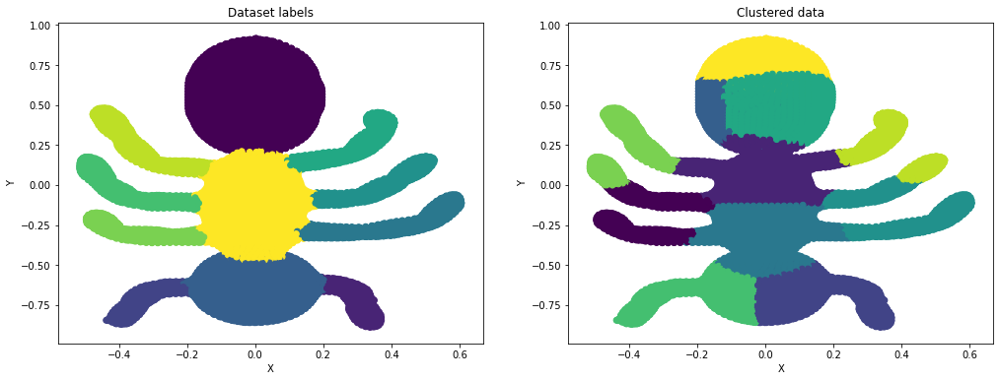

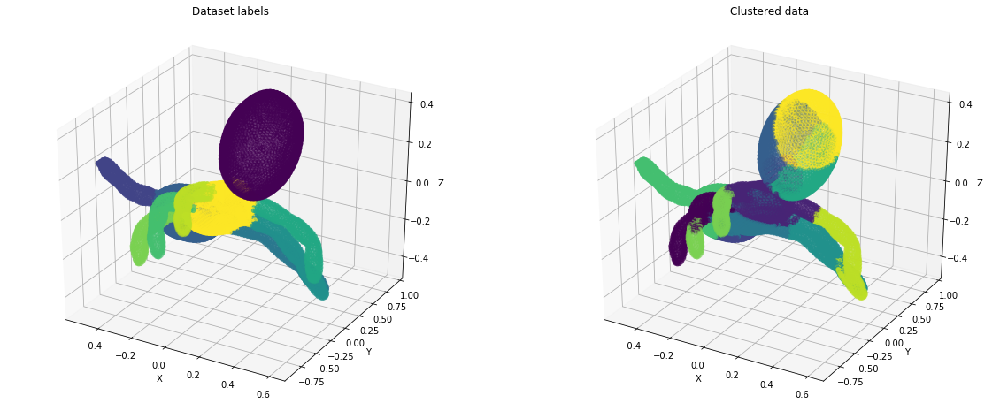

adjusted_rand_score:		 0.4233672252381878
adjusted_mutual_info_score:	 0.6605063397038402
homogeneity_score:		 0.728540752652694
completeness_score:		 0.6614162089732581
v_measure_score:		 0.693357673662623
fowlkes_mallows_score:		 0.5011090657602003
silhouette_score:		 0.3589431294760085

Average score:			 0.5753200564952589
----------------------------------------------------------------------------------------------------

Category: Chair
--------------------
CPU times: user 634 ms, sys: 26.4 ms, total: 660 ms
Wall time: 387 ms


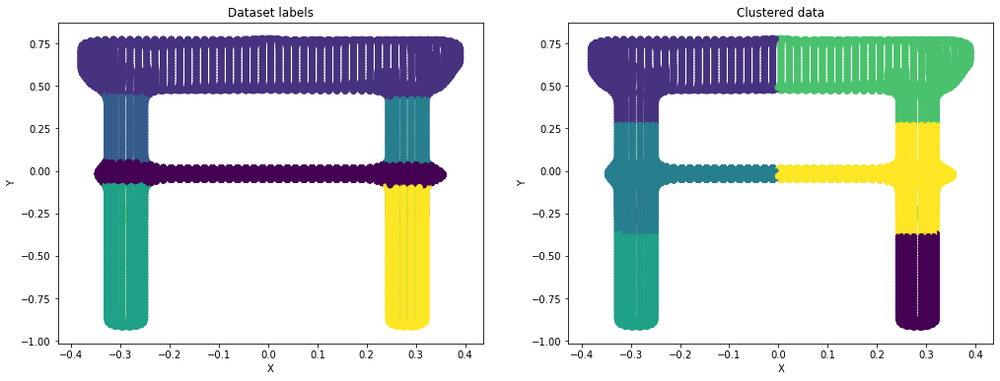

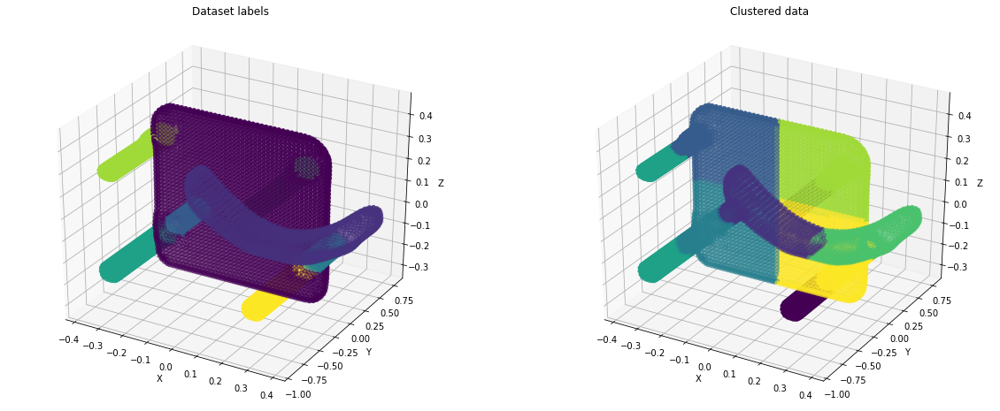

adjusted_rand_score:		 0.3200366543203708
adjusted_mutual_info_score:	 0.5362493499281302
homogeneity_score:		 0.6417032489406684
completeness_score:		 0.5367941489739241
v_measure_score:		 0.5845792277835339
fowlkes_mallows_score:		 0.4526824815806614
silhouette_score:		 0.40344711712624565

Average score:			 0.4964988898076478
----------------------------------------------------------------------------------------------------

Category: Octopus
--------------------
CPU times: user 1.98 s, sys: 173 ms, total: 2.15 s
Wall time: 1.18 s


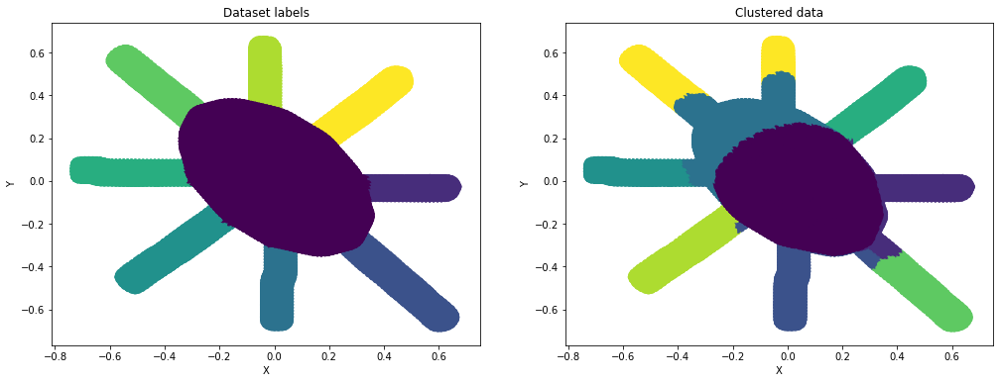

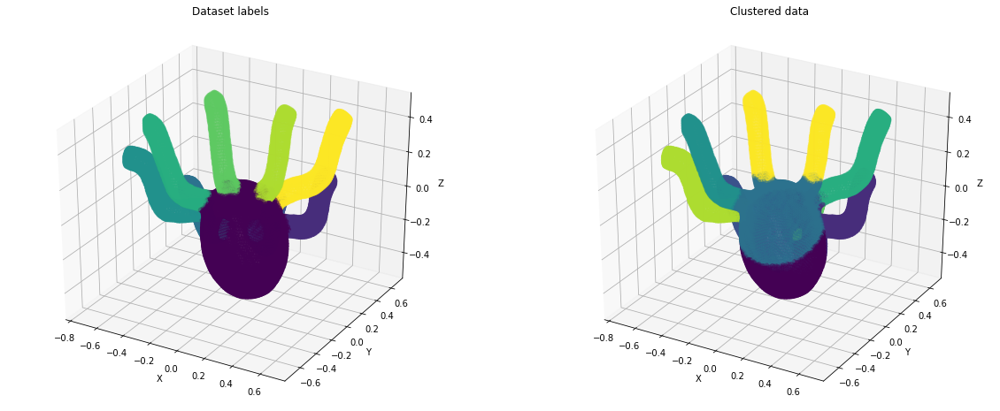

adjusted_rand_score:		 0.4234673119009825
adjusted_mutual_info_score:	 0.6724913570654153
homogeneity_score:		 0.7501602321316755
completeness_score:		 0.6728393950071154
v_measure_score:		 0.7093991412502946
fowlkes_mallows_score:		 0.529397571113148
silhouette_score:		 0.353279101984585

Average score:			 0.5872905872076023
----------------------------------------------------------------------------------------------------

Category: Table
--------------------
CPU times: user 595 ms, sys: 10.7 ms, total: 606 ms
Wall time: 307 ms


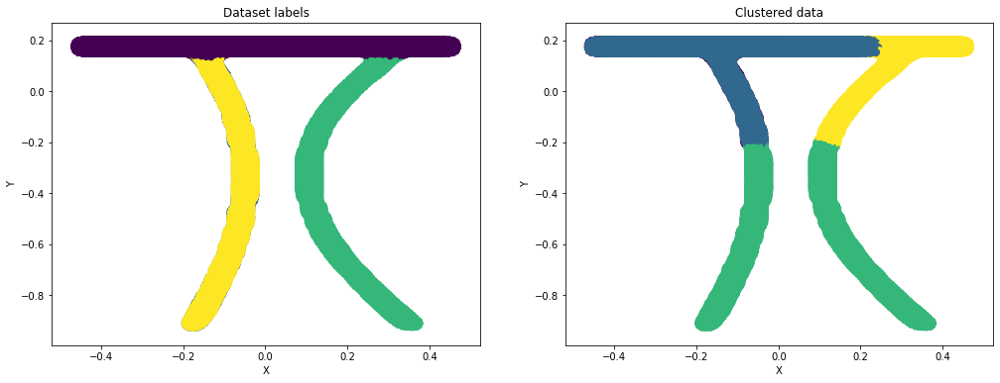

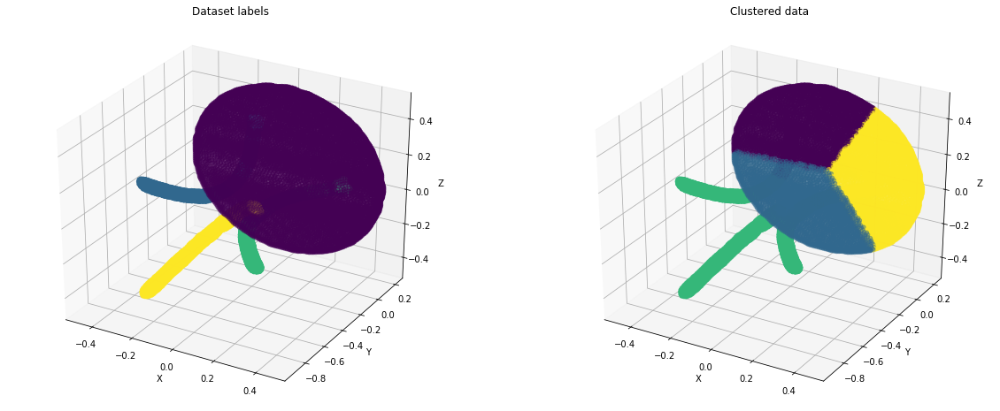

adjusted_rand_score:		 0.19223858236442826
adjusted_mutual_info_score:	 0.3087166679749917
homogeneity_score:		 0.4476119656981403
completeness_score:		 0.30888262969939567
v_measure_score:		 0.36552689706157715
fowlkes_mallows_score:		 0.4948038393662669
silhouette_score:		 0.38966688880713274

Average score:			 0.3582067815674189
----------------------------------------------------------------------------------------------------

Category: Teddy
--------------------
CPU times: user 1.15 s, sys: 19.5 ms, total: 1.17 s
Wall time: 588 ms


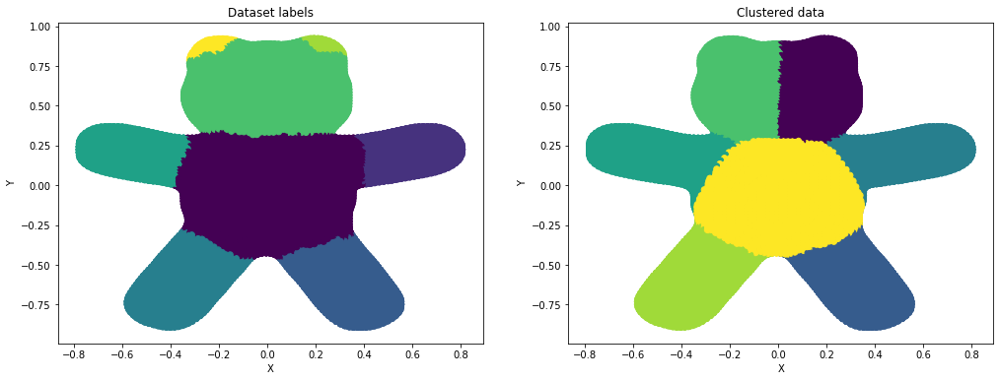

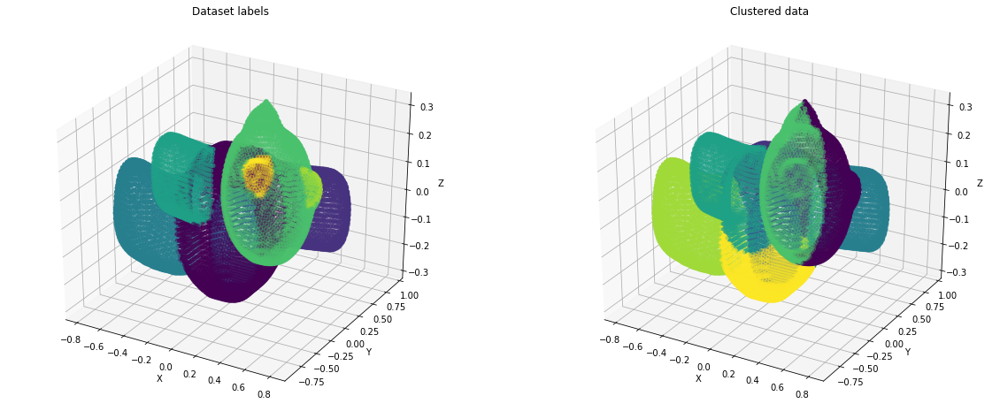

adjusted_rand_score:		 0.5921975440269078
adjusted_mutual_info_score:	 0.70523845964728
homogeneity_score:		 0.8123212672330172
completeness_score:		 0.7055174592095458
v_measure_score:		 0.7551617000355983
fowlkes_mallows_score:		 0.6661109746337066
silhouette_score:		 0.37419936937108816

Average score:			 0.6586781105938778
----------------------------------------------------------------------------------------------------

Category: Hand
--------------------
CPU times: user 1 s, sys: 28.3 ms, total: 1.03 s
Wall time: 556 ms


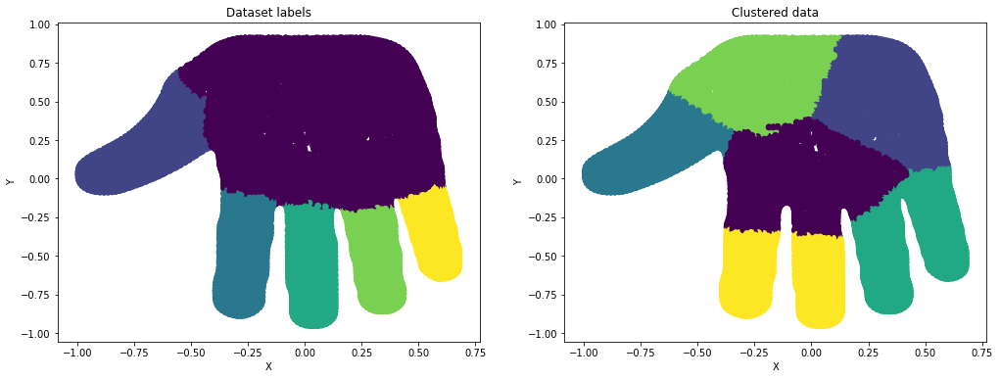

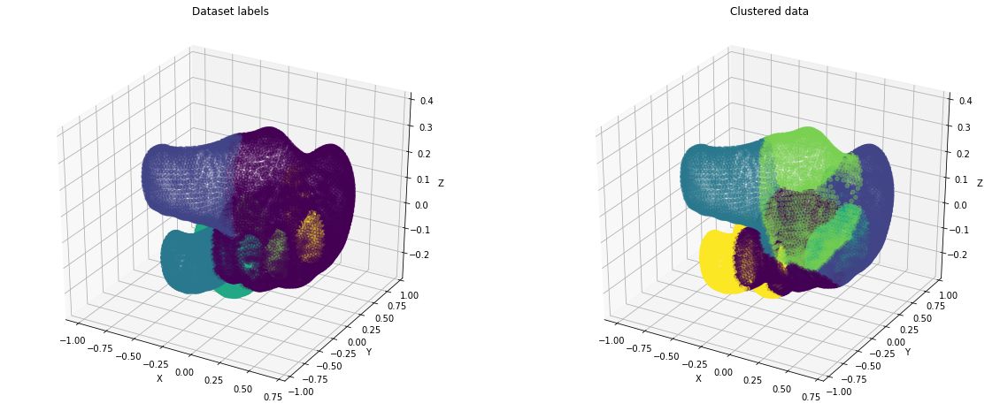

adjusted_rand_score:		 0.35314540314571935
adjusted_mutual_info_score:	 0.5545325758823376
homogeneity_score:		 0.629611264626551
completeness_score:		 0.5548073412690879
v_measure_score:		 0.5898471199654617
fowlkes_mallows_score:		 0.4994875056706706
silhouette_score:		 0.35759784653327886

Average score:			 0.5055755795847295
----------------------------------------------------------------------------------------------------

Category: Plier
--------------------
CPU times: user 241 ms, sys: 6.44 ms, total: 247 ms
Wall time: 129 ms


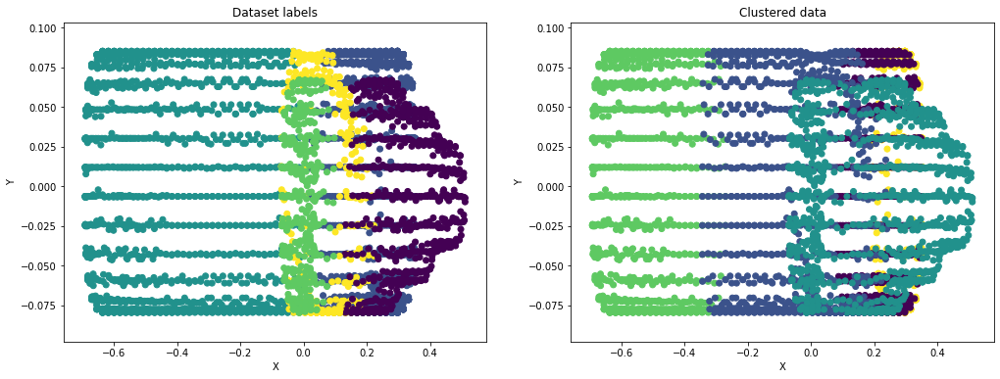

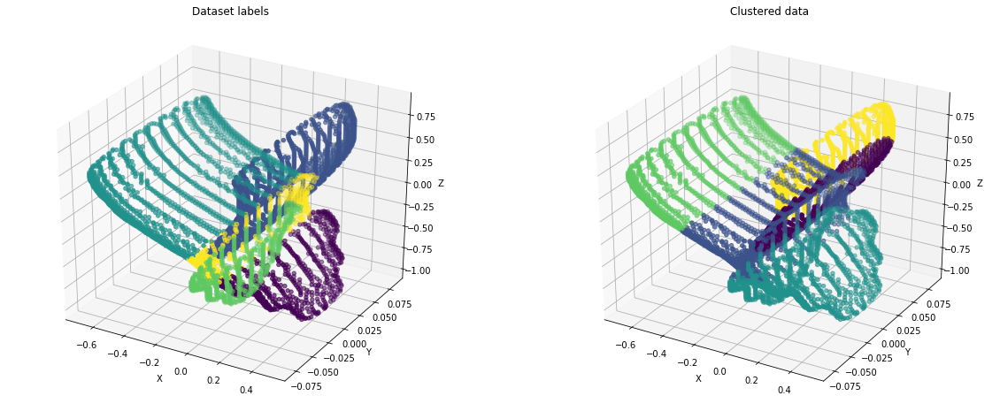

adjusted_rand_score:		 0.48237710901399883
adjusted_mutual_info_score:	 0.6305899841460201
homogeneity_score:		 0.6616176925804518
completeness_score:		 0.631008045691934
v_measure_score:		 0.6459504477272351
fowlkes_mallows_score:		 0.6009277367681748
silhouette_score:		 0.44543725430192255

Average score:			 0.5854154671756768
----------------------------------------------------------------------------------------------------

Category: Fish
--------------------
CPU times: user 483 ms, sys: 13.4 ms, total: 496 ms
Wall time: 263 ms


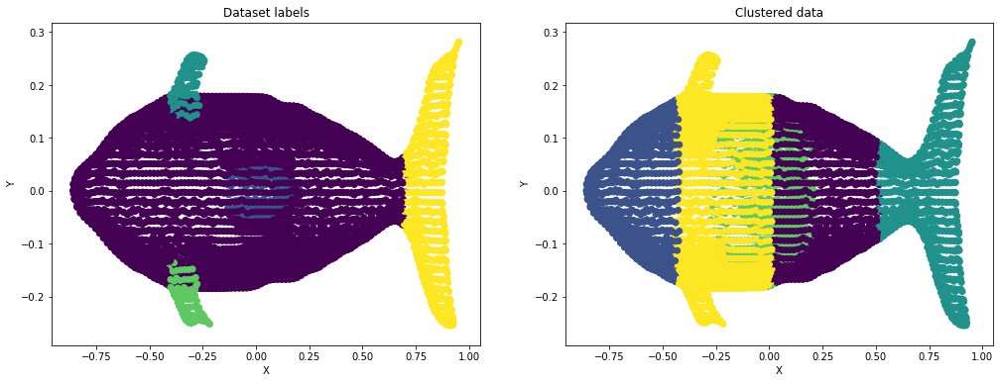

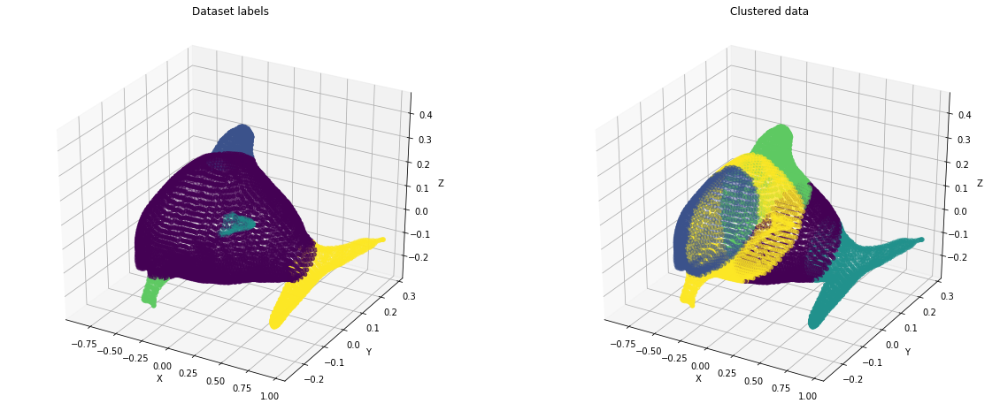

adjusted_rand_score:		 0.10087435077857712
adjusted_mutual_info_score:	 0.24301799203102492
homogeneity_score:		 0.5279226607982923
completeness_score:		 0.24374647293462232
v_measure_score:		 0.33350896369112104
fowlkes_mallows_score:		 0.44790506562614685
silhouette_score:		 0.3425908823058768

Average score:			 0.31993805545223736
----------------------------------------------------------------------------------------------------

Category: Bird
--------------------
CPU times: user 588 ms, sys: 17.8 ms, total: 606 ms
Wall time: 335 ms


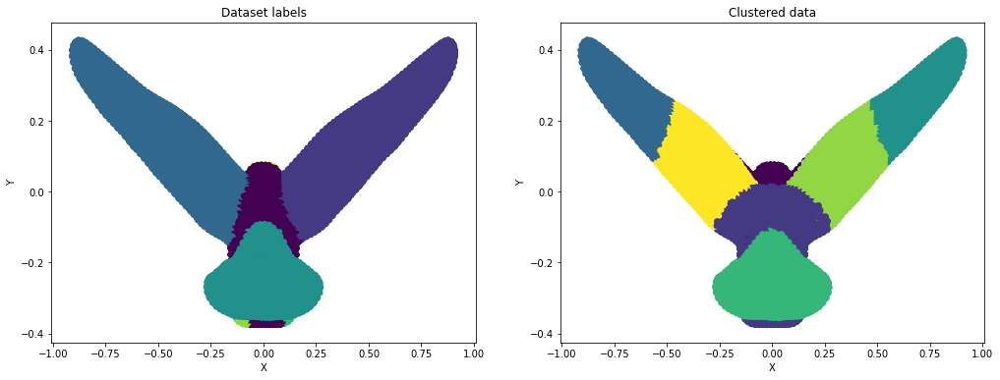

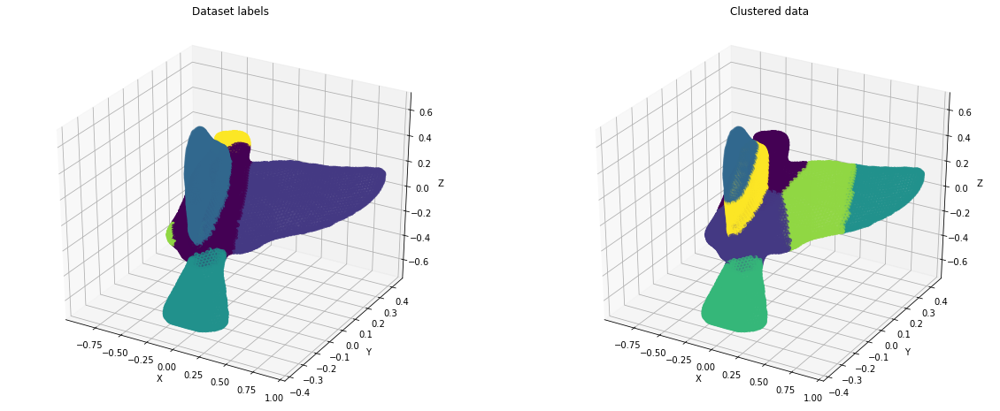

adjusted_rand_score:		 0.5184238242760704
adjusted_mutual_info_score:	 0.6005077934563375
homogeneity_score:		 0.7694601563198695
completeness_score:		 0.6009875326505233
v_measure_score:		 0.6748684601992931
fowlkes_mallows_score:		 0.6250869994011429
silhouette_score:		 0.3726285665933981

Average score:			 0.5945661904138049
----------------------------------------------------------------------------------------------------

Category: Armadillo
--------------------
CPU times: user 5.98 s, sys: 765 ms, total: 6.74 s
Wall time: 4.92 s


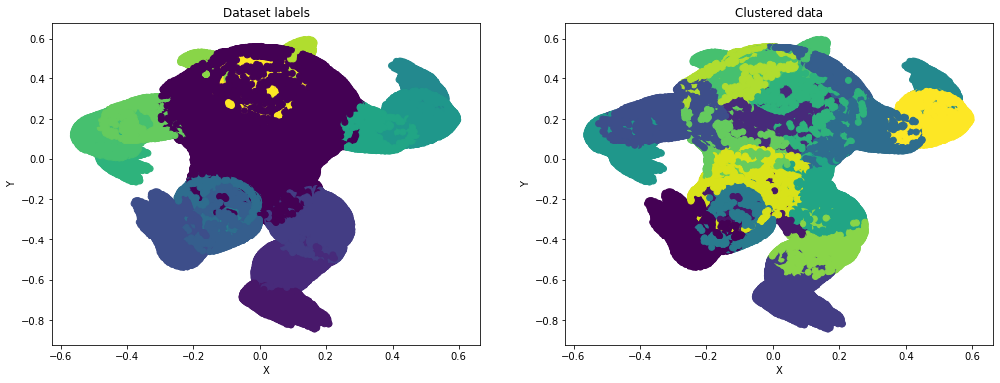

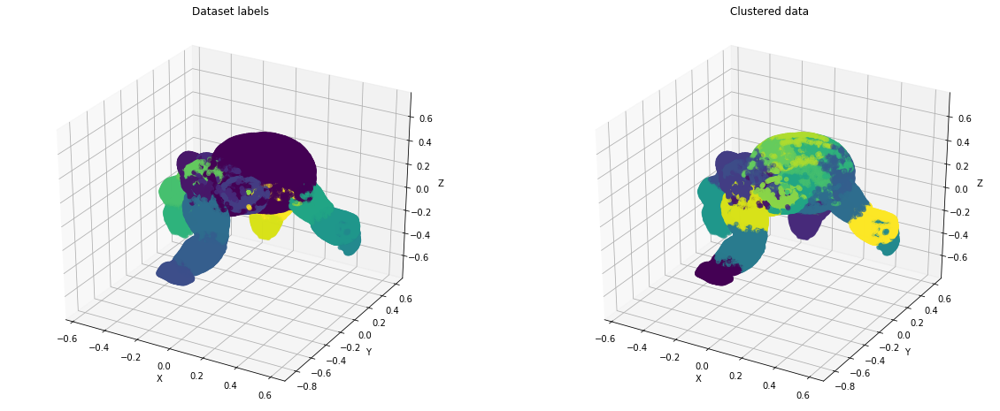

adjusted_rand_score:		 0.2522404305757519
adjusted_mutual_info_score:	 0.628611704244931
homogeneity_score:		 0.7421477283373252
completeness_score:		 0.629347965198712
v_measure_score:		 0.6811091932804081
fowlkes_mallows_score:		 0.3521185767456362
silhouette_score:		 0.34369126259151395

Average score:			 0.5184666944248969
----------------------------------------------------------------------------------------------------

Category: Bust
--------------------
CPU times: user 2.17 s, sys: 61 ms, total: 2.23 s
Wall time: 1.25 s


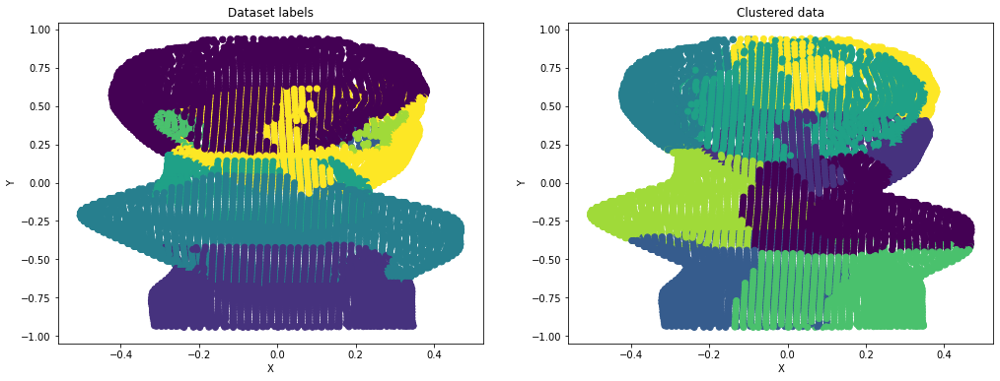

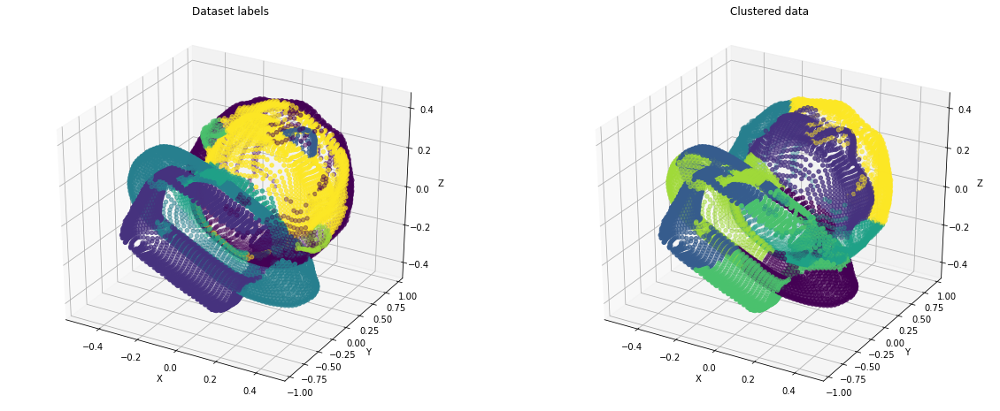

adjusted_rand_score:		 0.35734209529340394
adjusted_mutual_info_score:	 0.48775575729105014
homogeneity_score:		 0.6136943948283821
completeness_score:		 0.4884147209203324
v_measure_score:		 0.5439341210363746
fowlkes_mallows_score:		 0.476211202058819
silhouette_score:		 0.30886842853593954

Average score:			 0.46803153142347176
----------------------------------------------------------------------------------------------------

Category: Mech
--------------------
CPU times: user 624 ms, sys: 25.2 ms, total: 649 ms
Wall time: 402 ms


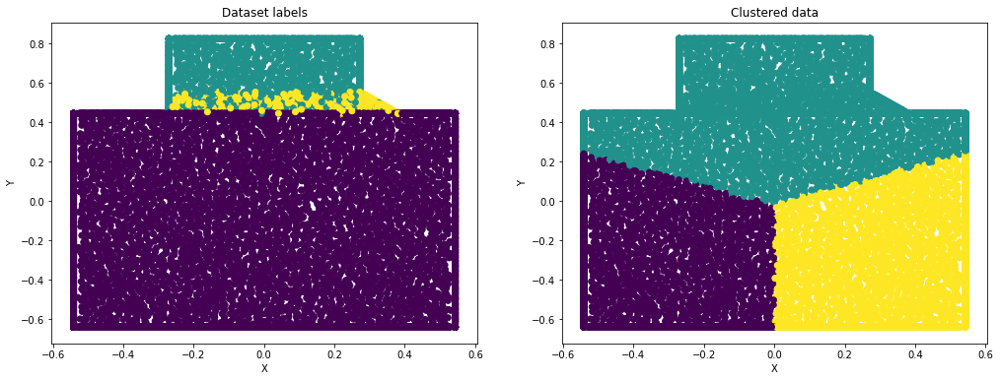

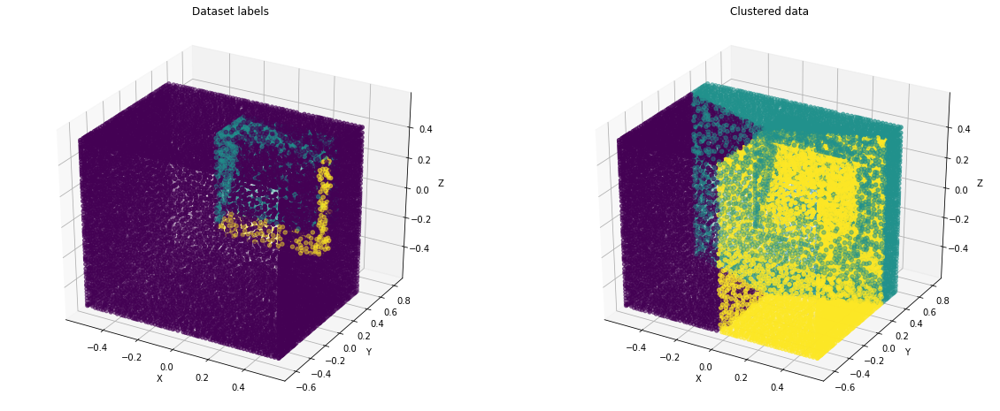

adjusted_rand_score:		 0.026265618196130717
adjusted_mutual_info_score:	 0.14868103067161761
homogeneity_score:		 0.3253814698787681
completeness_score:		 0.1487856088771052
v_measure_score:		 0.20419840297755096
fowlkes_mallows_score:		 0.5146748392151017
silhouette_score:		 0.29675576375689816

Average score:			 0.2378203905104532
----------------------------------------------------------------------------------------------------

Category: Bearing
--------------------
CPU times: user 628 ms, sys: 16.2 ms, total: 644 ms
Wall time: 344 ms


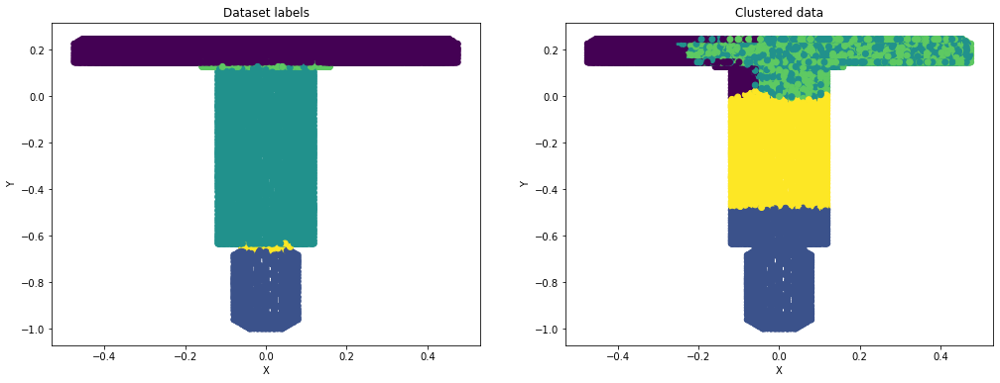

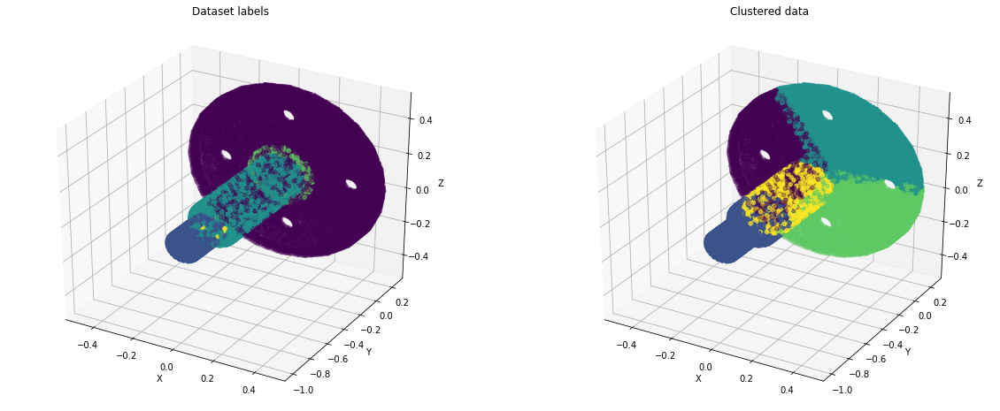

adjusted_rand_score:		 0.2796372688953525
adjusted_mutual_info_score:	 0.3564596802496693
homogeneity_score:		 0.612065616899916
completeness_score:		 0.3566916454470505
v_measure_score:		 0.45071908206331024
fowlkes_mallows_score:		 0.5382729493081553
silhouette_score:		 0.38260288836571976

Average score:			 0.4252070187470248
----------------------------------------------------------------------------------------------------

Category: Vase
--------------------
CPU times: user 400 ms, sys: 11.4 ms, total: 411 ms
Wall time: 223 ms


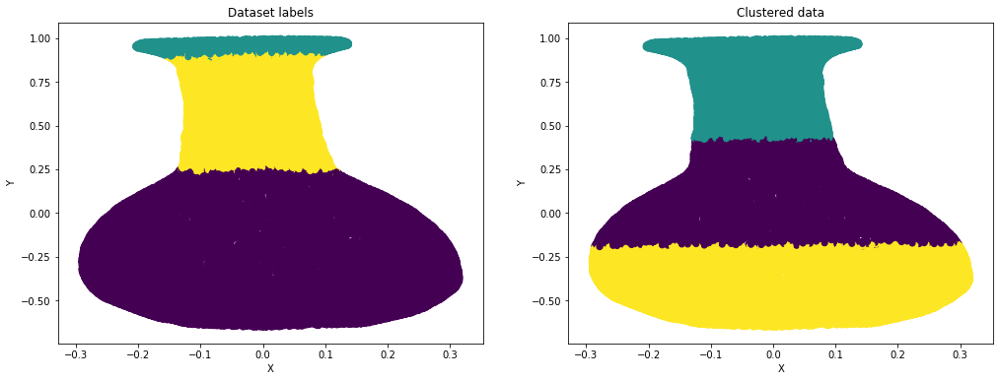

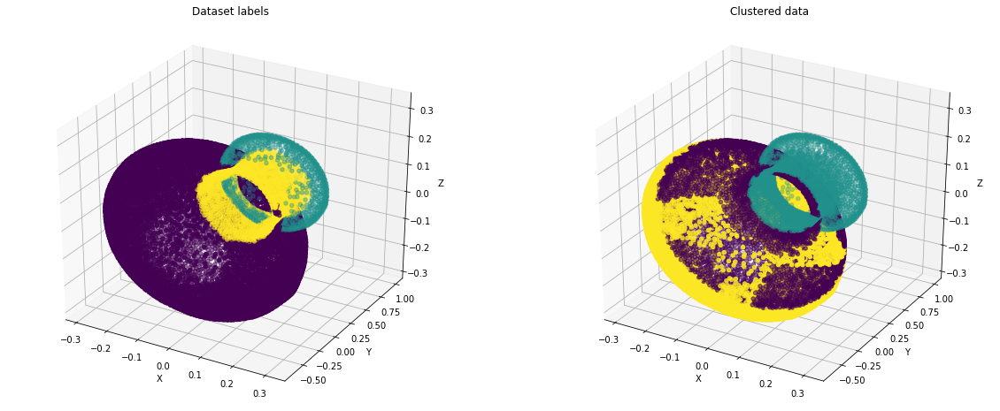

adjusted_rand_score:		 0.3973453891208504
adjusted_mutual_info_score:	 0.4420837076470982
homogeneity_score:		 0.6110290451174349
completeness_score:		 0.44216201560608087
v_measure_score:		 0.5130575908940612
fowlkes_mallows_score:		 0.6778049766940906
silhouette_score:		 0.39893876649184123

Average score:			 0.49748878451020817
----------------------------------------------------------------------------------------------------

Category: Fourleg
--------------------
CPU times: user 1.4 s, sys: 35.1 ms, total: 1.44 s
Wall time: 750 ms


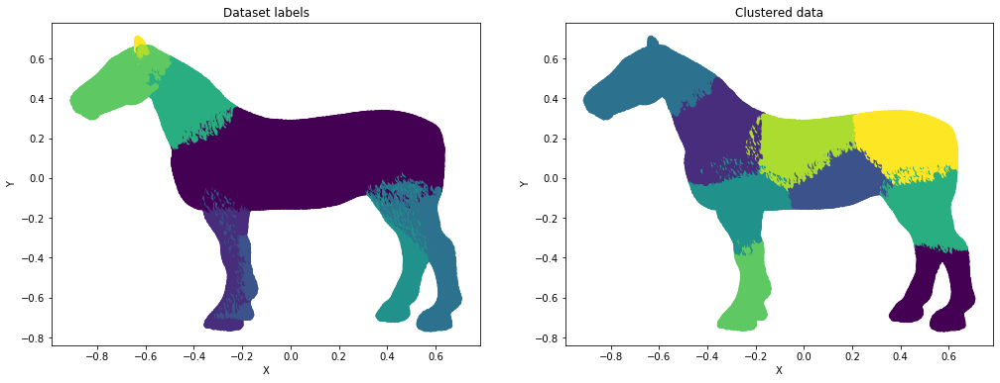

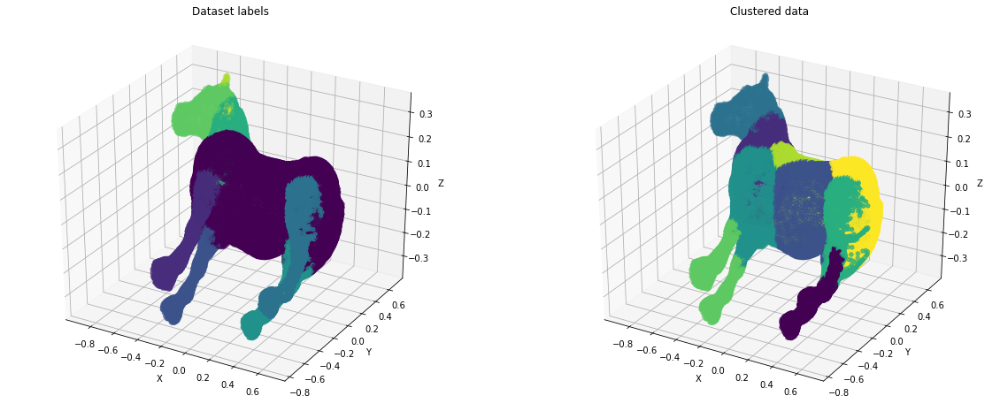

adjusted_rand_score:		 0.21710877936311654
adjusted_mutual_info_score:	 0.46656733527577726
homogeneity_score:		 0.6373681380117563
completeness_score:		 0.4671185666099353
v_measure_score:		 0.5391219102684848
fowlkes_mallows_score:		 0.38592614772595435
silhouette_score:		 0.35210046067228246

Average score:			 0.437901619703901
----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------

Average score per category: 0.5075724237879576


In [14]:
scores = []
for i in range(len(models)):
    print(f'\nCategory: {models[i][1]}')
    print('-' * 20)
    
    %time cluster = clust.KMeans(n_clusters=len(np.unique(data_labels[i])), verbose=0).fit(meshes[i])
    pred_labels = cluster.labels_

    plot_data(meshes[i], data_labels[i], pred_labels)
    scores.append(eval_scores(meshes[i], data_labels[i], pred_labels))
    
print('-' * 100)
print(f'\nAverage score per category: {np.average(scores)}')

### Agglomerative Clustering


Category: Human
--------------------
CPU times: user 5.17 s, sys: 814 ms, total: 5.98 s
Wall time: 6.09 s


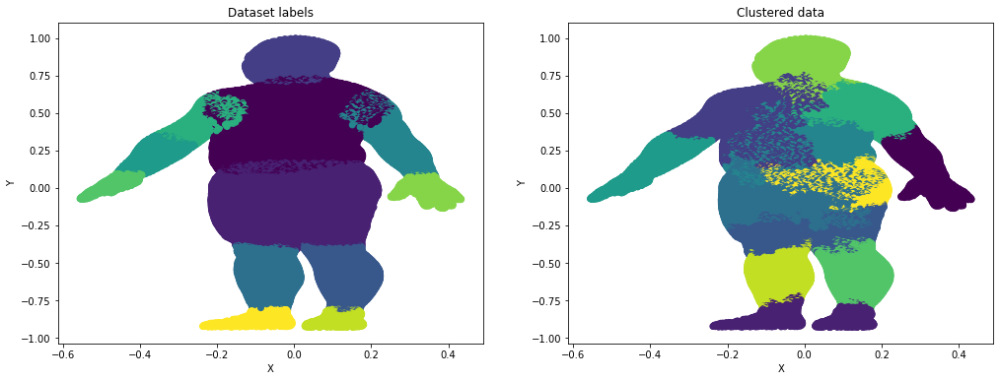

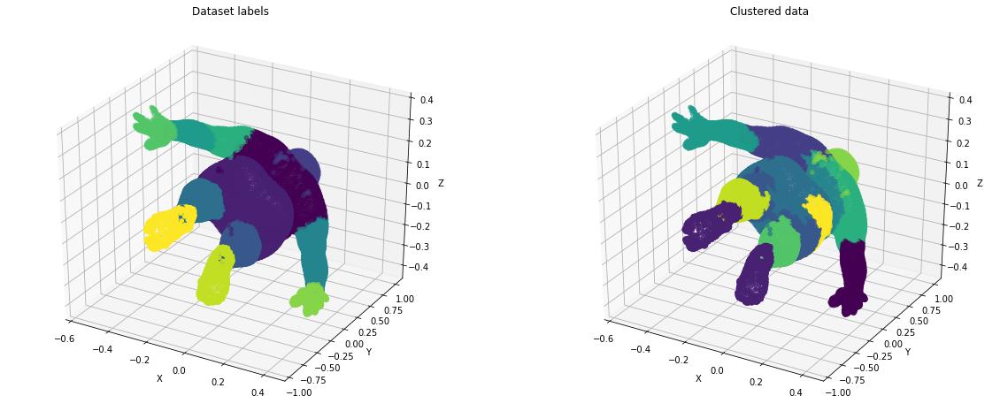

adjusted_rand_score:		 0.4872669129479561
adjusted_mutual_info_score:	 0.6948469796725412
homogeneity_score:		 0.7739644727260867
completeness_score:		 0.6953440343596463
v_measure_score:		 0.7325508241748602
fowlkes_mallows_score:		 0.5574691801442055
silhouette_score:		 0.30407493613586956

Average score:			 0.6065024771658808
----------------------------------------------------------------------------------------------------

Category: Cup
--------------------
CPU times: user 5.62 s, sys: 766 ms, total: 6.39 s
Wall time: 6.43 s


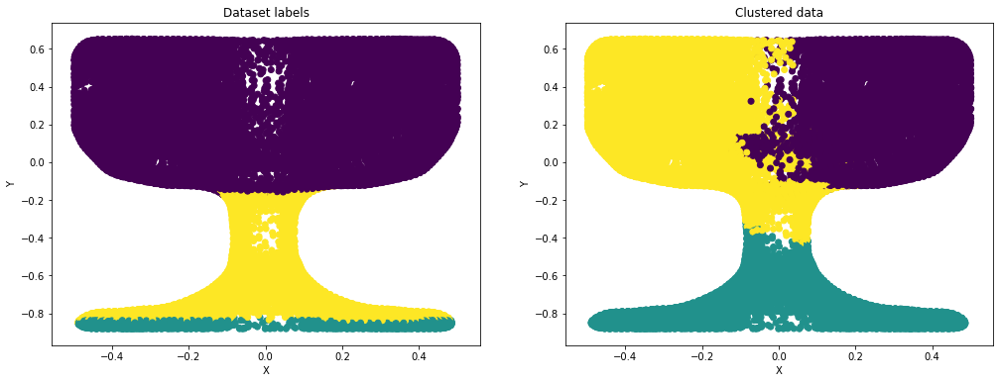

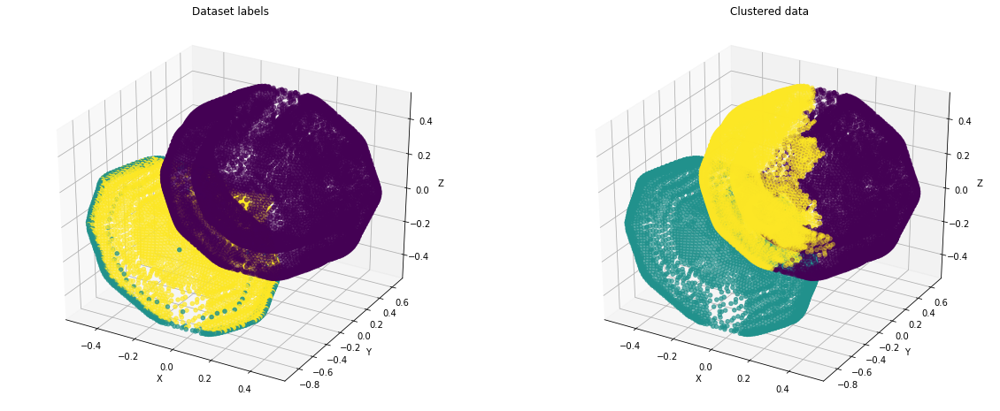

adjusted_rand_score:		 0.3927553324047462
adjusted_mutual_info_score:	 0.4489882969541373
homogeneity_score:		 0.6612956348783994
completeness_score:		 0.4490558696861577
v_measure_score:		 0.5348913118399146
fowlkes_mallows_score:		 0.677200111006338
silhouette_score:		 0.3401832066348657

Average score:			 0.500624251914937
----------------------------------------------------------------------------------------------------

Category: Glasses
--------------------
CPU times: user 1.21 s, sys: 166 ms, total: 1.37 s
Wall time: 1.37 s


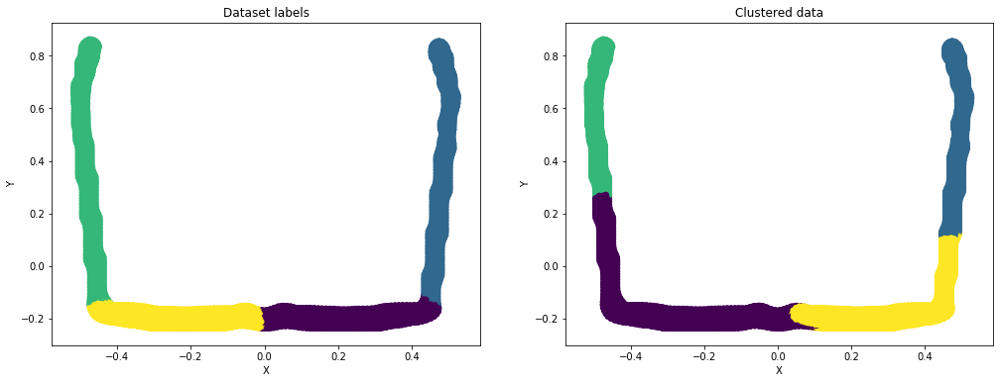

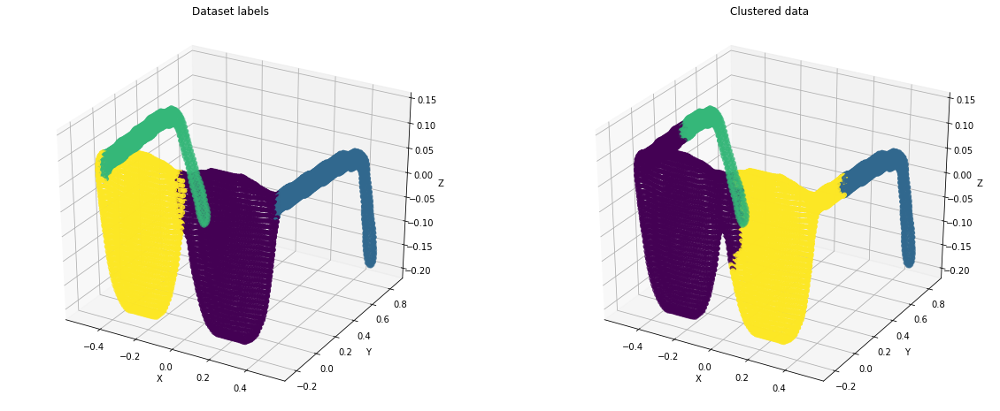

adjusted_rand_score:		 0.6607816218089863
adjusted_mutual_info_score:	 0.6791225507862522
homogeneity_score:		 0.6792688356744463
completeness_score:		 0.7361213964895263
v_measure_score:		 0.7065533060009986
fowlkes_mallows_score:		 0.7649674320811622
silhouette_score:		 0.5302075979976317

Average score:			 0.6795746772627148
----------------------------------------------------------------------------------------------------

Category: Airplane
--------------------
CPU times: user 1.74 s, sys: 182 ms, total: 1.92 s
Wall time: 1.92 s


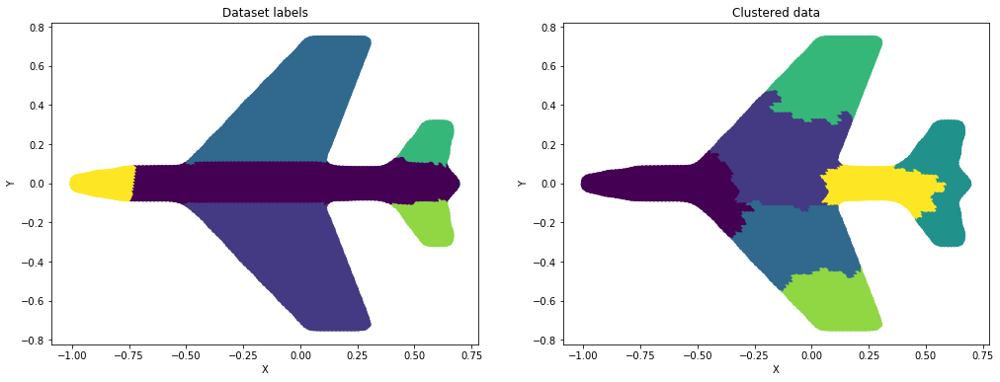

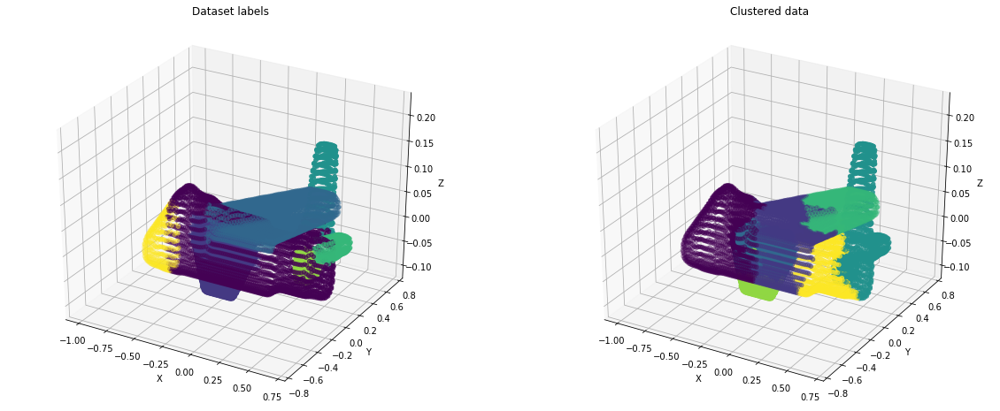

adjusted_rand_score:		 0.38480916631769485
adjusted_mutual_info_score:	 0.5337706160507657
homogeneity_score:		 0.6353887952225437
completeness_score:		 0.5343429374688107
v_measure_score:		 0.5805015043796666
fowlkes_mallows_score:		 0.5117915845633192
silhouette_score:		 0.36560964154257414

Average score:			 0.5066020350779107
----------------------------------------------------------------------------------------------------

Category: Ant
--------------------
CPU times: user 1.54 s, sys: 188 ms, total: 1.73 s
Wall time: 1.73 s


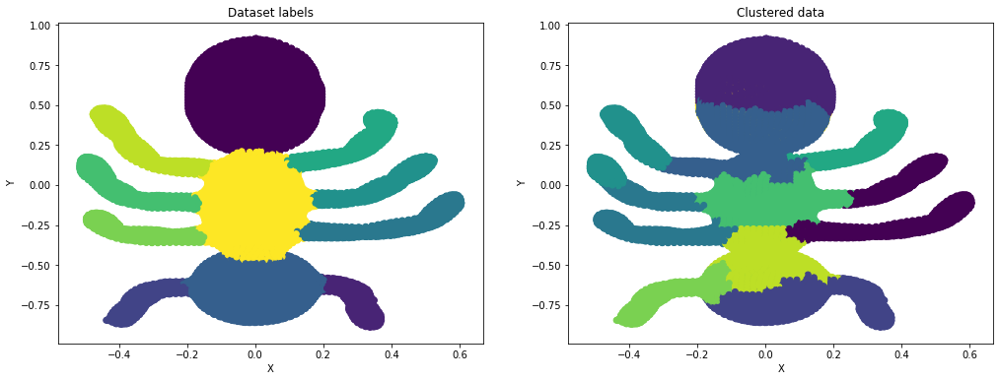

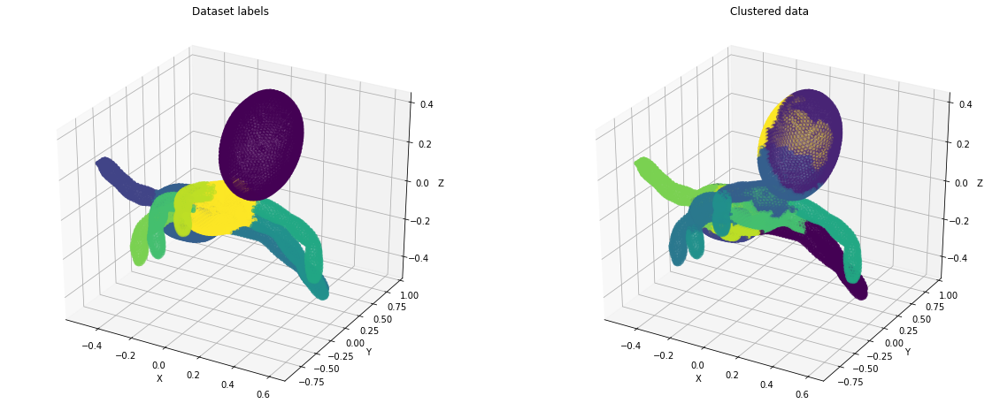

adjusted_rand_score:		 0.4856459226715486
adjusted_mutual_info_score:	 0.6872849921404223
homogeneity_score:		 0.7481614845603338
completeness_score:		 0.6881343429333601
v_measure_score:		 0.7168935559526758
fowlkes_mallows_score:		 0.5564332874592824
silhouette_score:		 0.28589718403898684

Average score:			 0.5954929671080871
----------------------------------------------------------------------------------------------------

Category: Chair
--------------------
CPU times: user 2.37 s, sys: 324 ms, total: 2.69 s
Wall time: 2.69 s


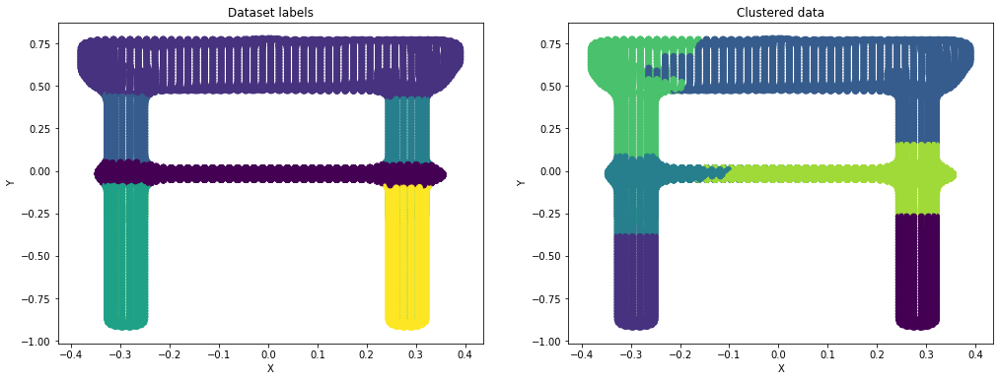

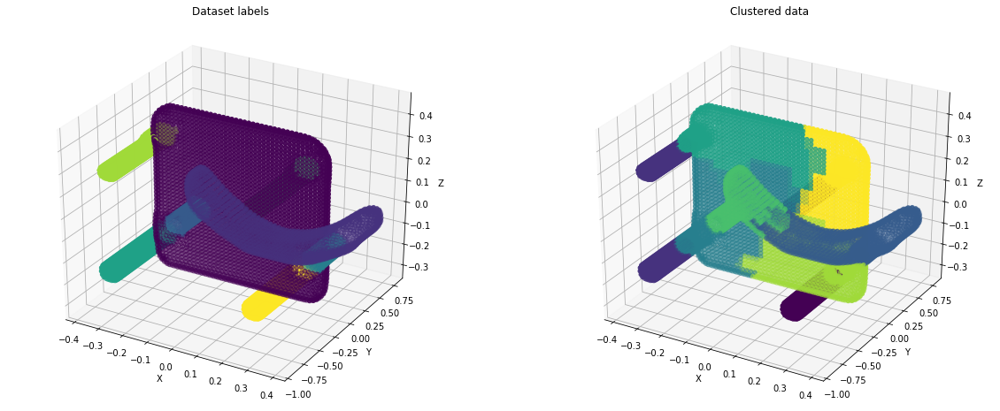

adjusted_rand_score:		 0.3648064494207816
adjusted_mutual_info_score:	 0.5647722767478536
homogeneity_score:		 0.6715796521024199
completeness_score:		 0.5652867789857156
v_measure_score:		 0.6138659580814069
fowlkes_mallows_score:		 0.4917684532986412
silhouette_score:		 0.3319745658305553

Average score:			 0.514864876352482
----------------------------------------------------------------------------------------------------

Category: Octopus
--------------------
CPU times: user 6.24 s, sys: 711 ms, total: 6.96 s
Wall time: 7.38 s


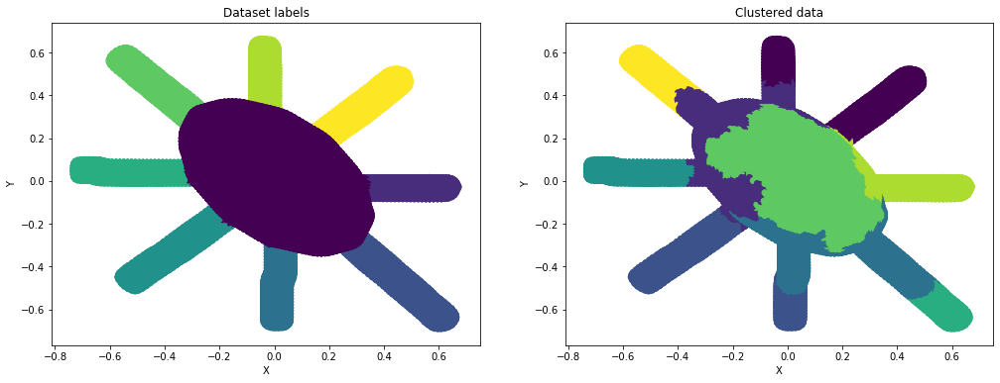

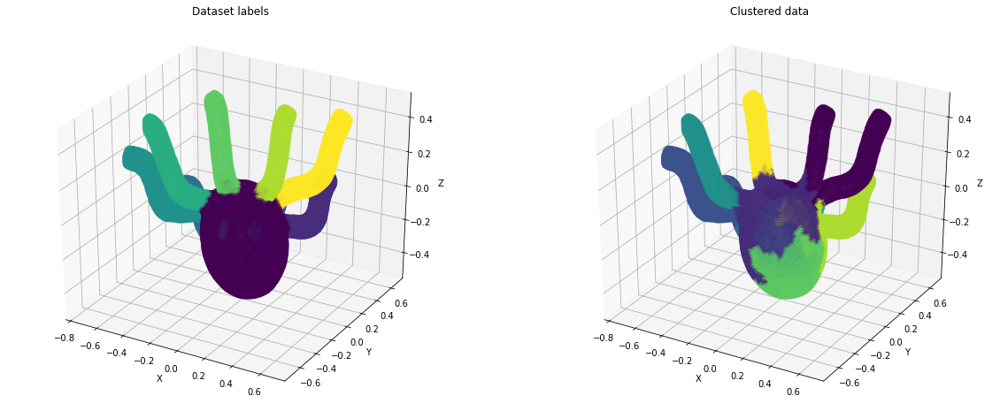

adjusted_rand_score:		 0.3109072984441932
adjusted_mutual_info_score:	 0.595059563482059
homogeneity_score:		 0.655080069829477
completeness_score:		 0.5954957885105521
v_measure_score:		 0.6238684684645259
fowlkes_mallows_score:		 0.43208132238067426
silhouette_score:		 0.2742025184771272

Average score:			 0.4980992899412298
----------------------------------------------------------------------------------------------------

Category: Table
--------------------
CPU times: user 4.35 s, sys: 536 ms, total: 4.88 s
Wall time: 4.88 s


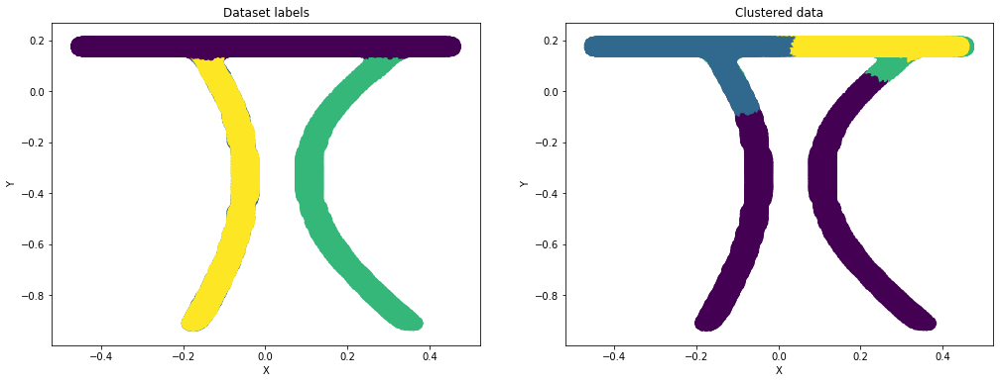

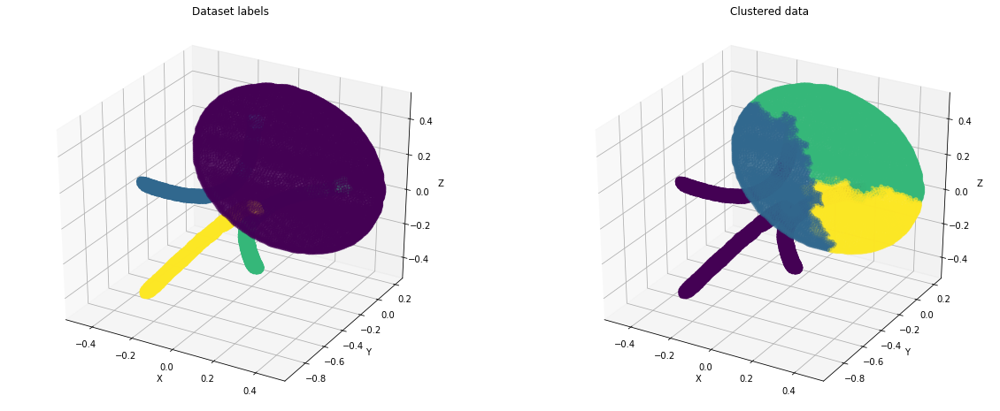

adjusted_rand_score:		 0.2290581606503566
adjusted_mutual_info_score:	 0.3630154255661161
homogeneity_score:		 0.5202503403184298
completeness_score:		 0.36317012801828374
v_measure_score:		 0.42774508734381295
fowlkes_mallows_score:		 0.5236312978746891
silhouette_score:		 0.3304818664727297

Average score:			 0.39390747232063117
----------------------------------------------------------------------------------------------------

Category: Teddy
--------------------
CPU times: user 4.5 s, sys: 466 ms, total: 4.96 s
Wall time: 4.96 s


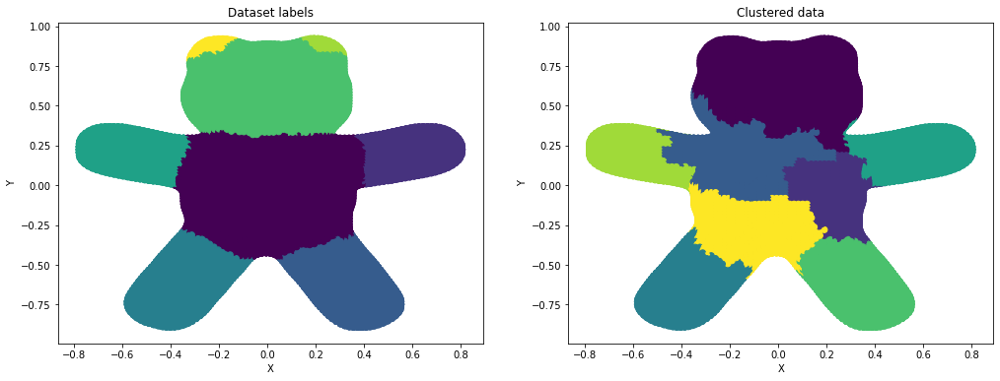

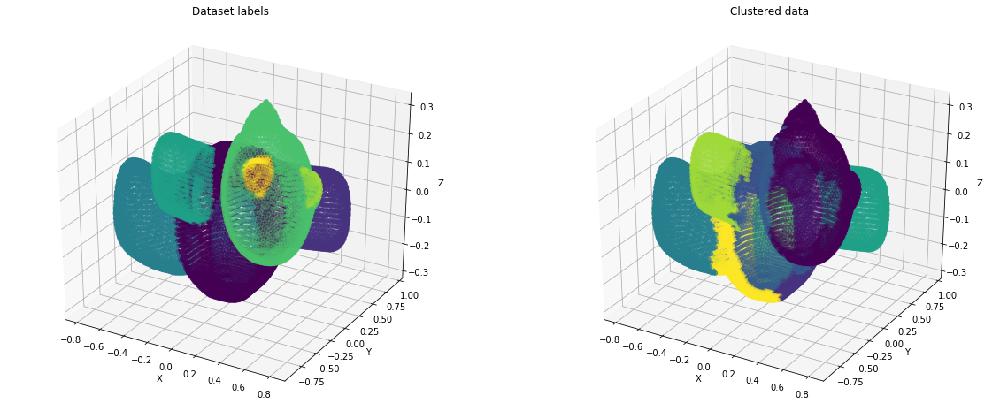

adjusted_rand_score:		 0.5964023852579081
adjusted_mutual_info_score:	 0.6761594895953885
homogeneity_score:		 0.7652562472298321
completeness_score:		 0.676471568876354
v_measure_score:		 0.7181301329874152
fowlkes_mallows_score:		 0.6682735531248734
silhouette_score:		 0.3104561485237718

Average score:			 0.6301642179422203
----------------------------------------------------------------------------------------------------

Category: Hand
--------------------
CPU times: user 3.63 s, sys: 402 ms, total: 4.03 s
Wall time: 3.92 s


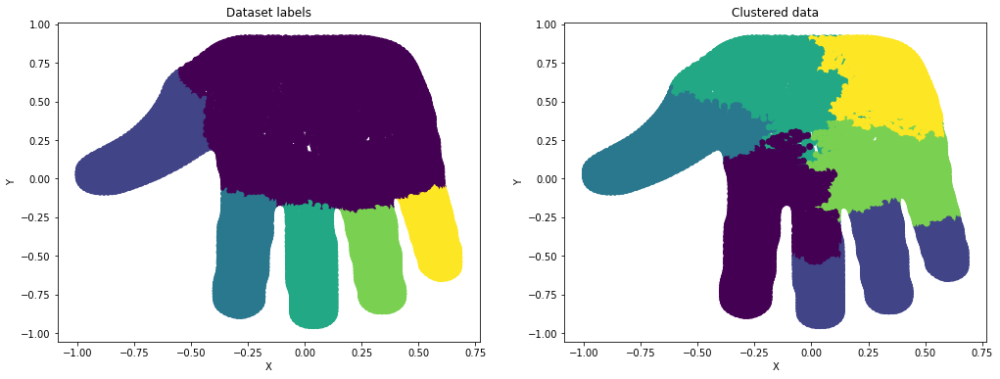

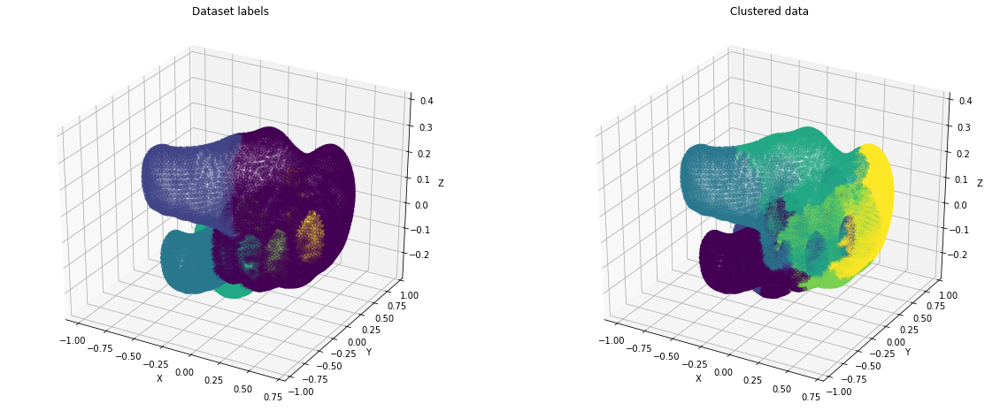

adjusted_rand_score:		 0.2842968592770029
adjusted_mutual_info_score:	 0.49217316314640164
homogeneity_score:		 0.5532201255474545
completeness_score:		 0.49248961610998565
v_measure_score:		 0.5210913820566404
fowlkes_mallows_score:		 0.44527480426417265
silhouette_score:		 0.290378951042044

Average score:			 0.4398464144919573
----------------------------------------------------------------------------------------------------

Category: Plier
--------------------
CPU times: user 442 ms, sys: 63.9 ms, total: 506 ms
Wall time: 511 ms


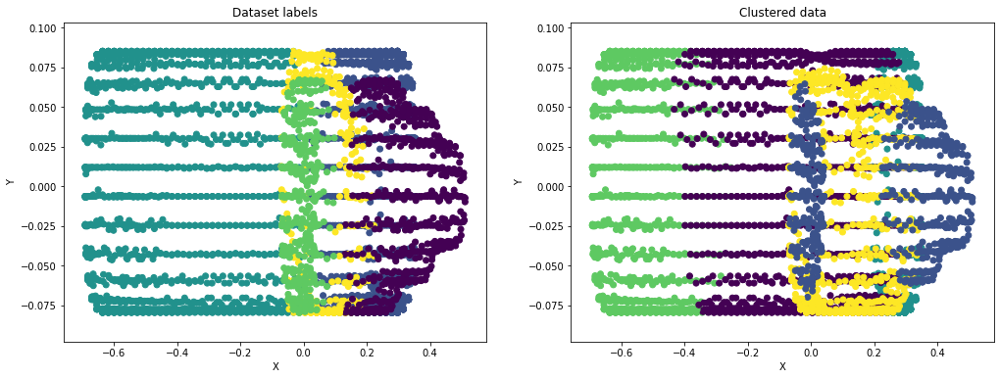

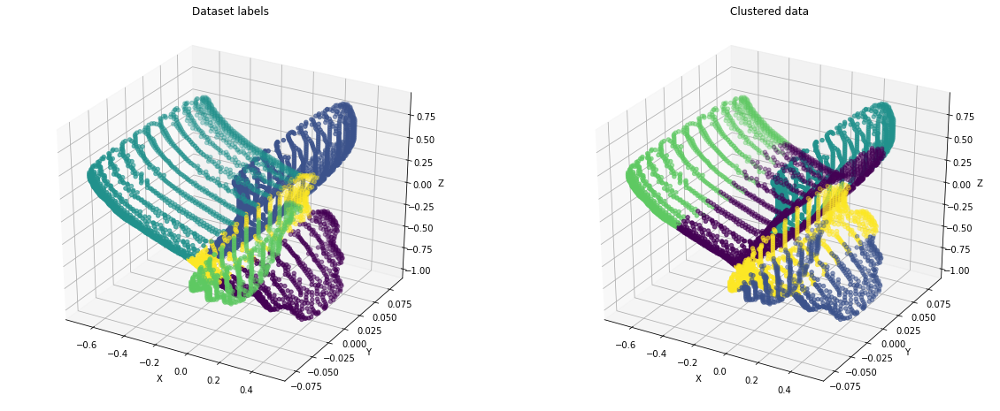

adjusted_rand_score:		 0.44800326768310267
adjusted_mutual_info_score:	 0.5840284286559675
homogeneity_score:		 0.6199746122317911
completeness_score:		 0.5844937369564845
v_measure_score:		 0.601711581986723
fowlkes_mallows_score:		 0.5727577726980656
silhouette_score:		 0.41044265419644044

Average score:			 0.5459160077726536
----------------------------------------------------------------------------------------------------

Category: Fish
--------------------
CPU times: user 745 ms, sys: 106 ms, total: 851 ms
Wall time: 842 ms


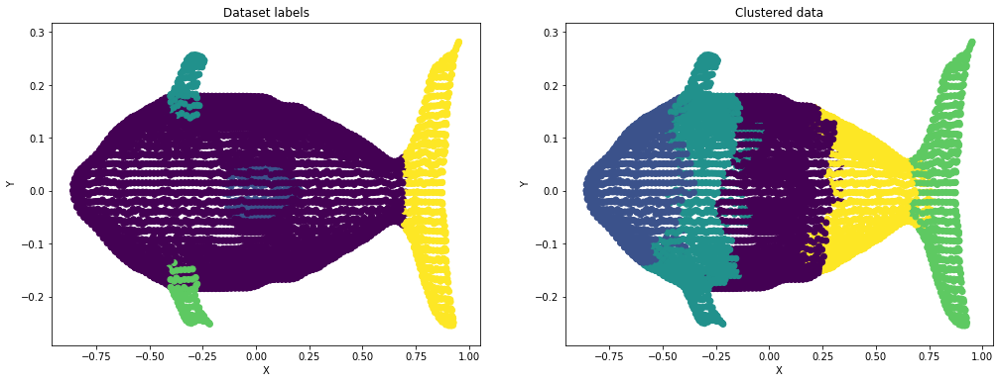

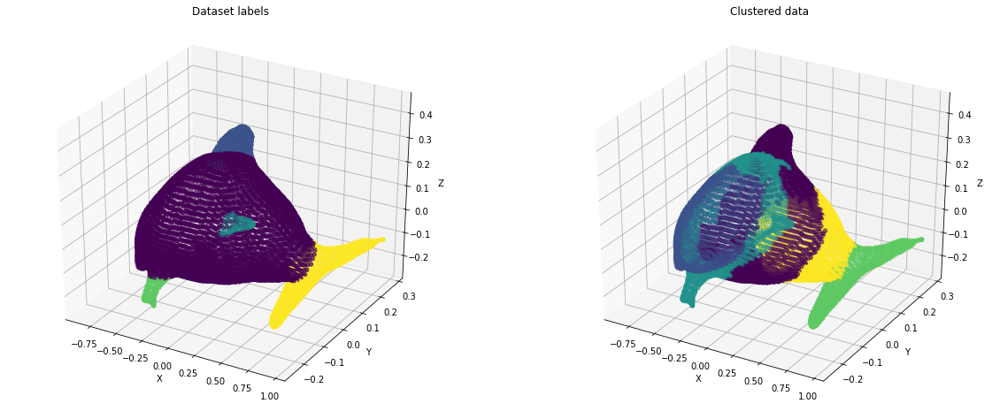

adjusted_rand_score:		 0.11160518634623628
adjusted_mutual_info_score:	 0.26958844212314365
homogeneity_score:		 0.5697021873541436
completeness_score:		 0.2703113356718423
v_measure_score:		 0.3666535239673869
fowlkes_mallows_score:		 0.46727207506518864
silhouette_score:		 0.25958506327698844

Average score:			 0.3306739734007043
----------------------------------------------------------------------------------------------------

Category: Bird
--------------------
CPU times: user 1.65 s, sys: 275 ms, total: 1.92 s
Wall time: 1.9 s


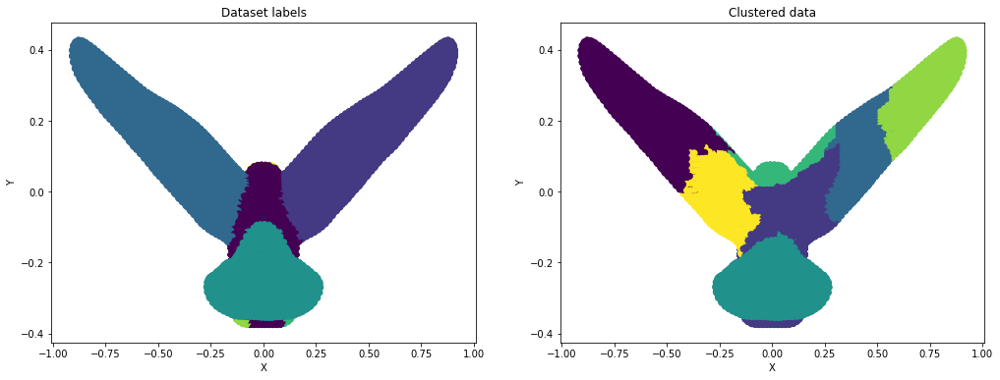

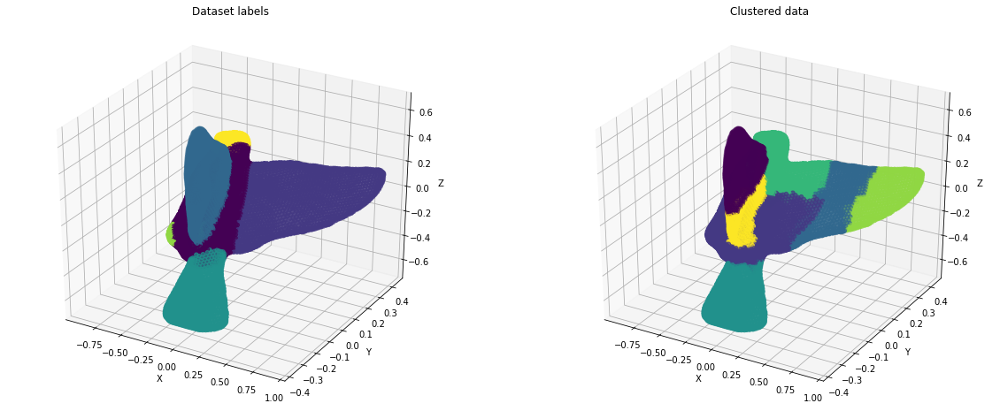

adjusted_rand_score:		 0.4667958054734184
adjusted_mutual_info_score:	 0.5522045619450602
homogeneity_score:		 0.6863099959278984
completeness_score:		 0.5527612488541017
v_measure_score:		 0.6123385915826067
fowlkes_mallows_score:		 0.5812509981460575
silhouette_score:		 0.3124852782166959

Average score:			 0.5377352114494056
----------------------------------------------------------------------------------------------------

Category: Armadillo
--------------------
CPU times: user 35 s, sys: 6.39 s, total: 41.4 s
Wall time: 45.8 s


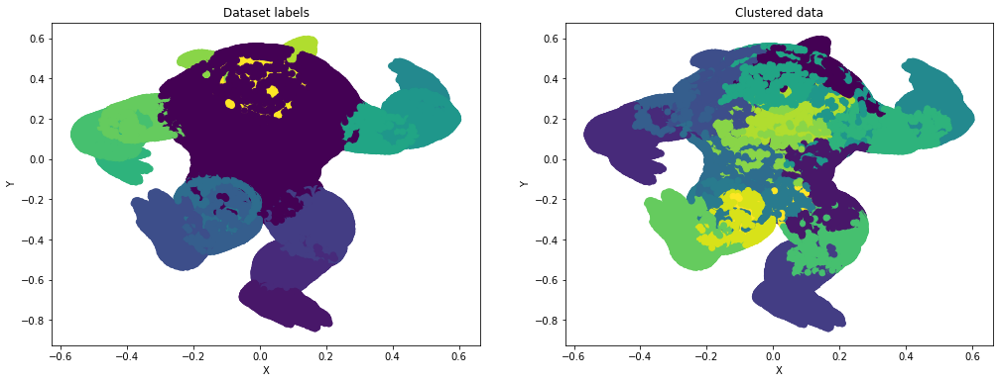

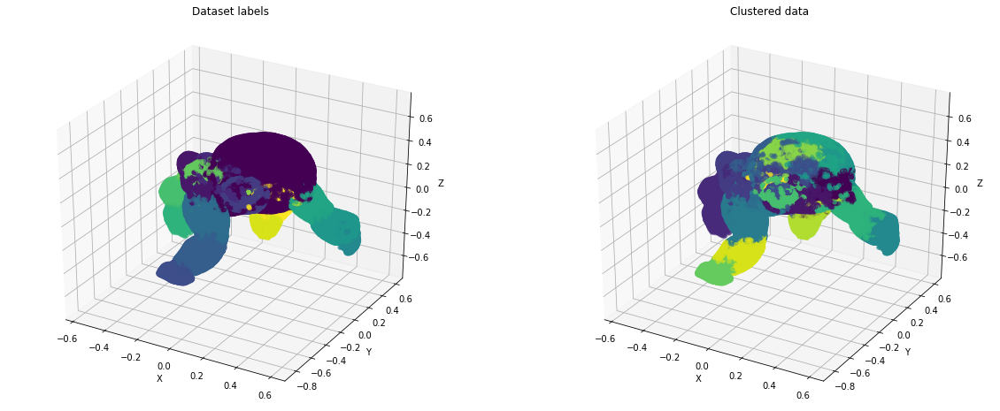

adjusted_rand_score:		 0.2482823110167526
adjusted_mutual_info_score:	 0.6131156242242647
homogeneity_score:		 0.718369169032175
completeness_score:		 0.6138886715131328
v_measure_score:		 0.6620320502713639
fowlkes_mallows_score:		 0.34694439100608837
silhouette_score:		 0.28786272788466305

Average score:			 0.4986421349926343
----------------------------------------------------------------------------------------------------

Category: Bust
--------------------
CPU times: user 2.49 s, sys: 295 ms, total: 2.79 s
Wall time: 3.12 s


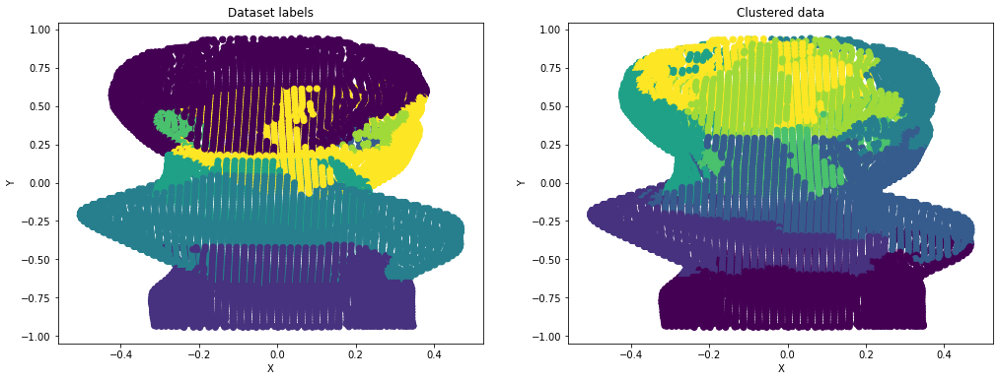

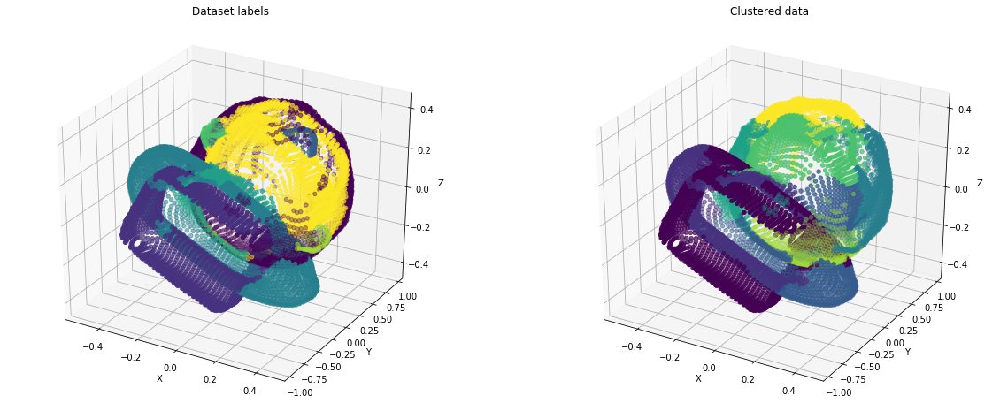

adjusted_rand_score:		 0.33068641056208525
adjusted_mutual_info_score:	 0.4509965631086447
homogeneity_score:		 0.5508396285006486
completeness_score:		 0.4517252003737823
v_measure_score:		 0.496383145292723
fowlkes_mallows_score:		 0.45506576655228737
silhouette_score:		 0.2645294812092727

Average score:			 0.42860374222849196
----------------------------------------------------------------------------------------------------

Category: Mech
--------------------
CPU times: user 8.39 s, sys: 855 ms, total: 9.24 s
Wall time: 9.58 s


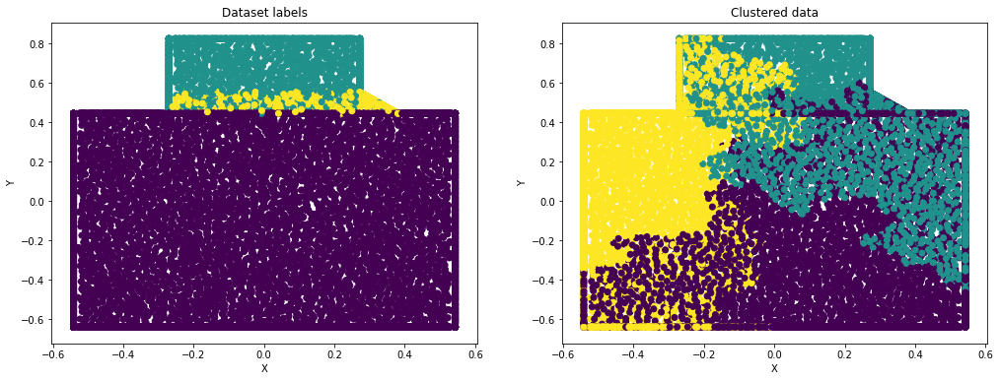

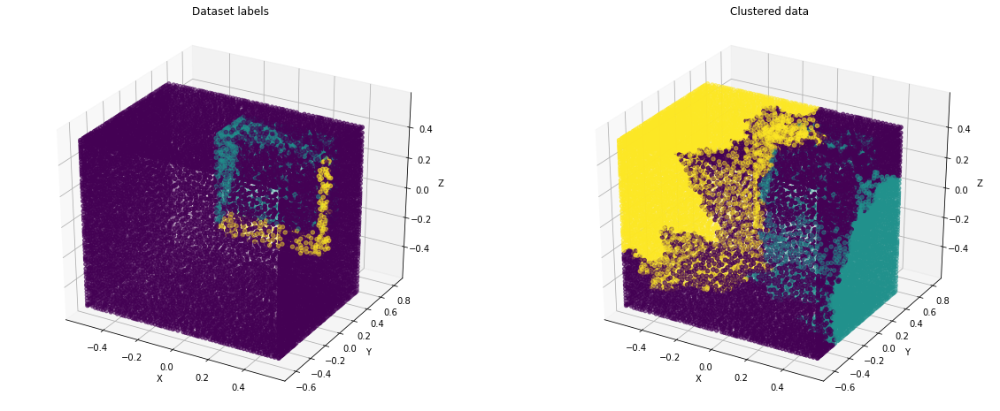

adjusted_rand_score:		 0.08041374079430479
adjusted_mutual_info_score:	 0.09013960155775955
homogeneity_score:		 0.1979058531459285
completeness_score:		 0.09025106882148955
v_measure_score:		 0.12396866714496879
fowlkes_mallows_score:		 0.5442299067780753
silhouette_score:		 0.20385141895610054

Average score:			 0.1901086081712324
----------------------------------------------------------------------------------------------------

Category: Bearing
--------------------
CPU times: user 7.21 s, sys: 692 ms, total: 7.9 s
Wall time: 8.06 s


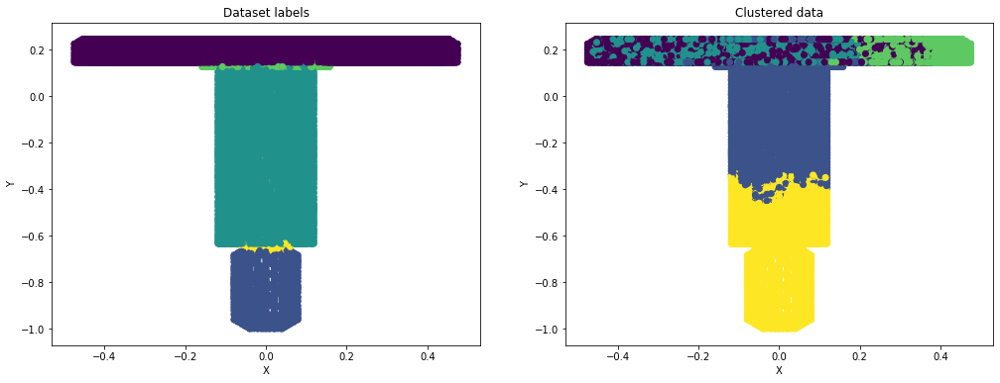

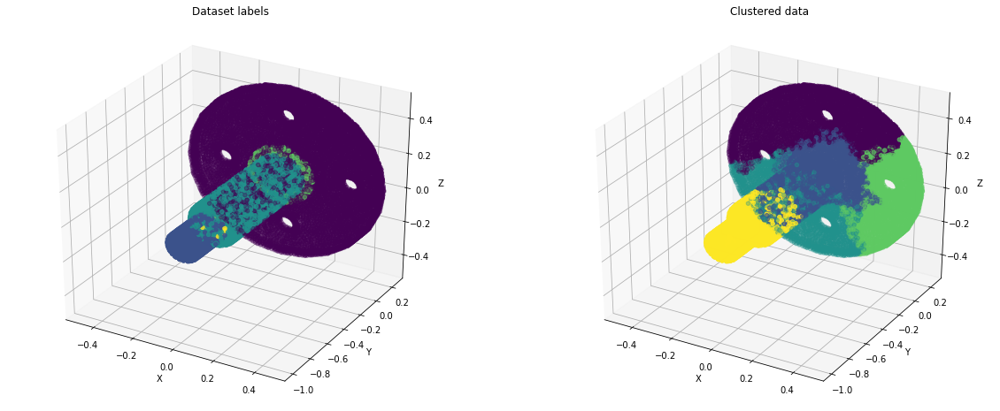

adjusted_rand_score:		 0.2379266752445265
adjusted_mutual_info_score:	 0.3626523622057489
homogeneity_score:		 0.627295726829094
completeness_score:		 0.3628803577466971
v_measure_score:		 0.459783469446726
fowlkes_mallows_score:		 0.5047887516632229
silhouette_score:		 0.3286977525728207

Average score:			 0.4120035851012623
----------------------------------------------------------------------------------------------------

Category: Vase
--------------------
CPU times: user 4.65 s, sys: 634 ms, total: 5.28 s
Wall time: 5.32 s


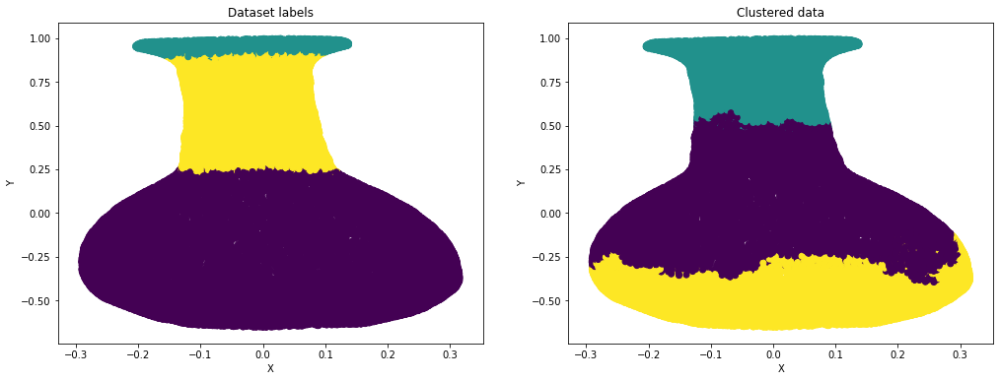

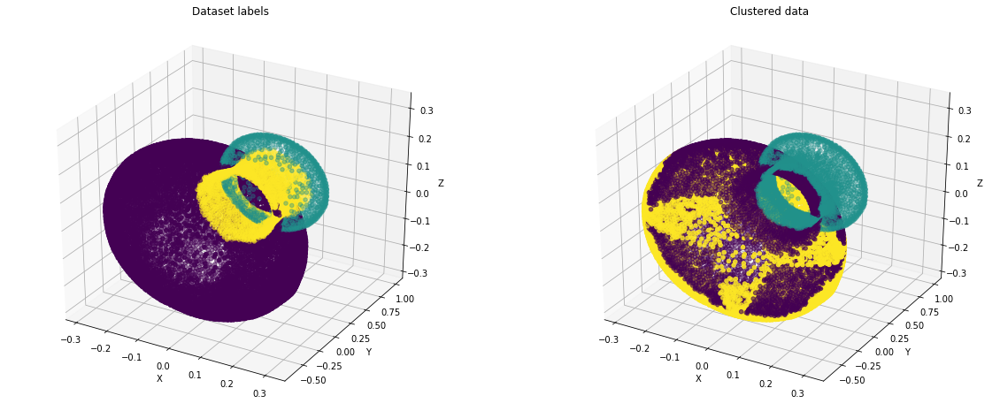

adjusted_rand_score:		 0.3231915591929954
adjusted_mutual_info_score:	 0.4032970355139415
homogeneity_score:		 0.5537454621284893
completeness_score:		 0.40338134718120766
v_measure_score:		 0.4667523432343739
fowlkes_mallows_score:		 0.6358346098808094
silhouette_score:		 0.3732129468563358

Average score:			 0.451345043426879
----------------------------------------------------------------------------------------------------

Category: Fourleg
--------------------
CPU times: user 6.56 s, sys: 683 ms, total: 7.25 s
Wall time: 7.24 s


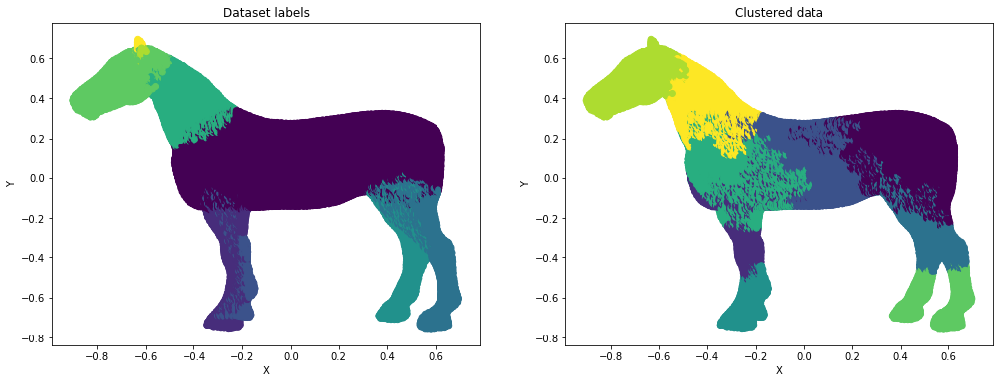

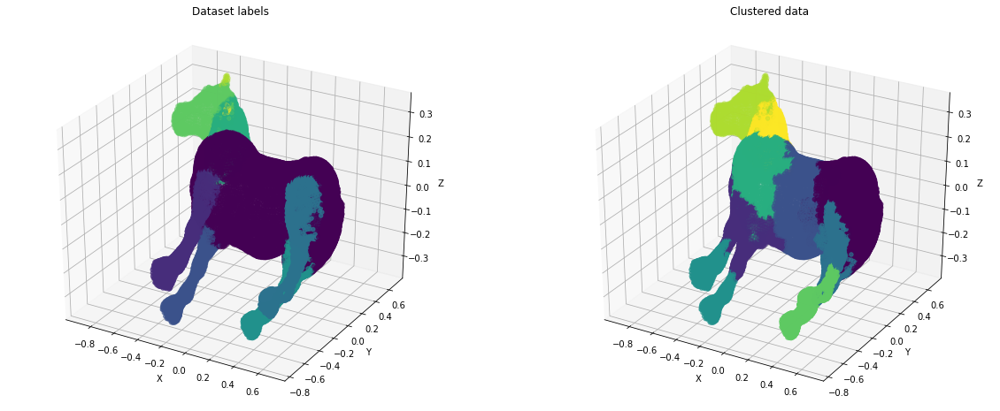

adjusted_rand_score:		 0.29427970205131243
adjusted_mutual_info_score:	 0.4829807215919813
homogeneity_score:		 0.6443246390551056
completeness_score:		 0.48352845289132995
v_measure_score:		 0.5524643202323659
fowlkes_mallows_score:		 0.4573429913831363
silhouette_score:		 0.2621320433477688

Average score:			 0.45386469579328576
----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------

Average score per category: 0.4849774569428737


In [21]:
scores = []
for i in range(len(models)):
    print(f'\nCategory: {models[i][1]}')
    print('-' * 20)
    
    %time cluster = clust.AgglomerativeClustering(n_clusters=len(np.unique(data_labels[i]))).fit(meshes[i])
    pred_labels = cluster.labels_

    plot_data(meshes[i], data_labels[i], pred_labels)
    scores.append(eval_scores(meshes[i], data_labels[i], pred_labels))
    
print('-' * 100)
print(f'\nAverage score per category: {np.average(scores)}')

### Birch


Category: Human
--------------------
CPU times: user 2.32 s, sys: 290 ms, total: 2.61 s
Wall time: 2.3 s


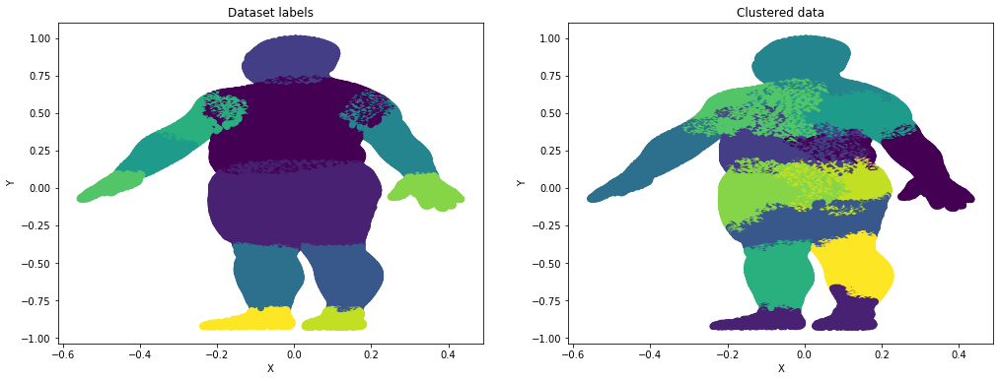

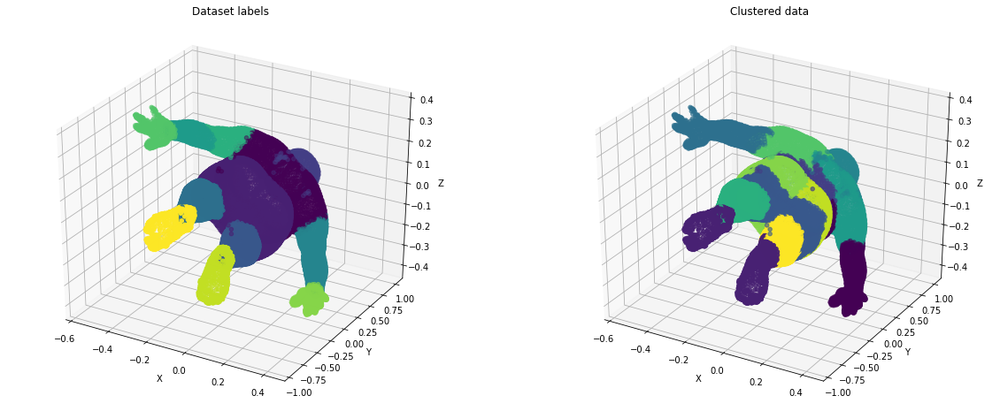

adjusted_rand_score:		 0.45217745836579964
adjusted_mutual_info_score:	 0.6698987162395379
homogeneity_score:		 0.7476972105065406
completeness_score:		 0.6704353439987734
v_measure_score:		 0.7069616093930482
fowlkes_mallows_score:		 0.5255329536664424
silhouette_score:		 0.3023854112861162

Average score:			 0.5821555290651798
----------------------------------------------------------------------------------------------------

Category: Cup
--------------------
CPU times: user 4.04 s, sys: 617 ms, total: 4.66 s
Wall time: 4.33 s


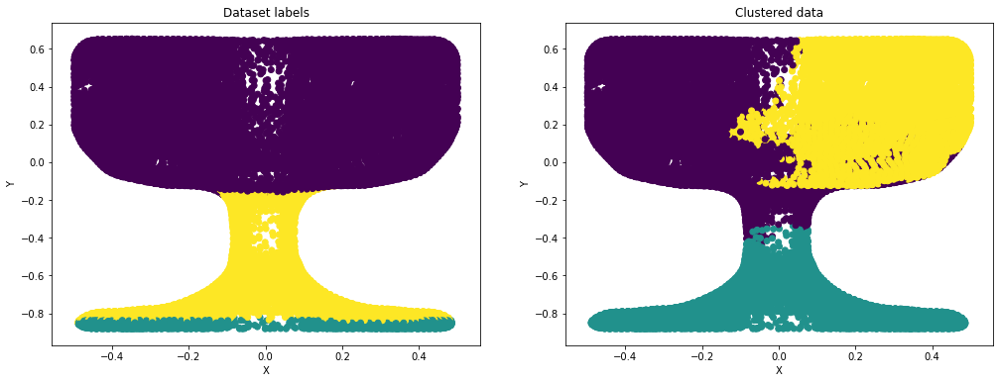

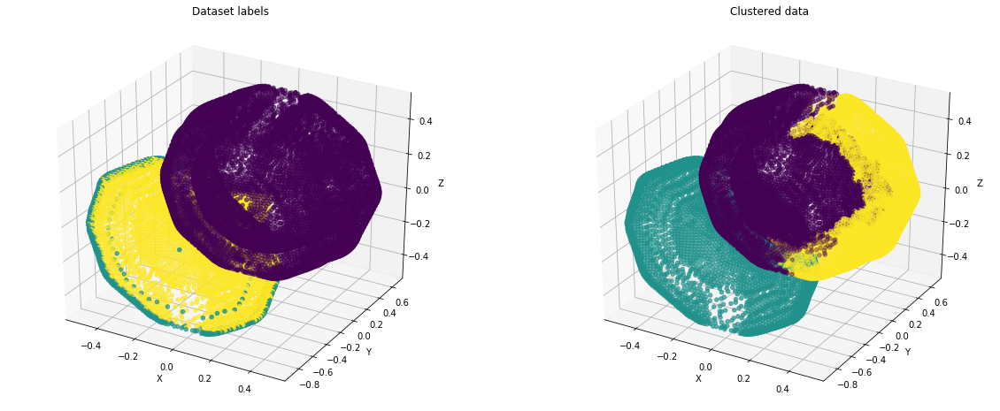

adjusted_rand_score:		 0.4122051264579605
adjusted_mutual_info_score:	 0.463414175947019
homogeneity_score:		 0.664427817067823
completeness_score:		 0.46348177506564836
v_measure_score:		 0.5460547302822247
fowlkes_mallows_score:		 0.6935615941120677
silhouette_score:		 0.306639661766092

Average score:			 0.5071121258141192
----------------------------------------------------------------------------------------------------

Category: Glasses
--------------------
CPU times: user 537 ms, sys: 49.8 ms, total: 587 ms
Wall time: 527 ms


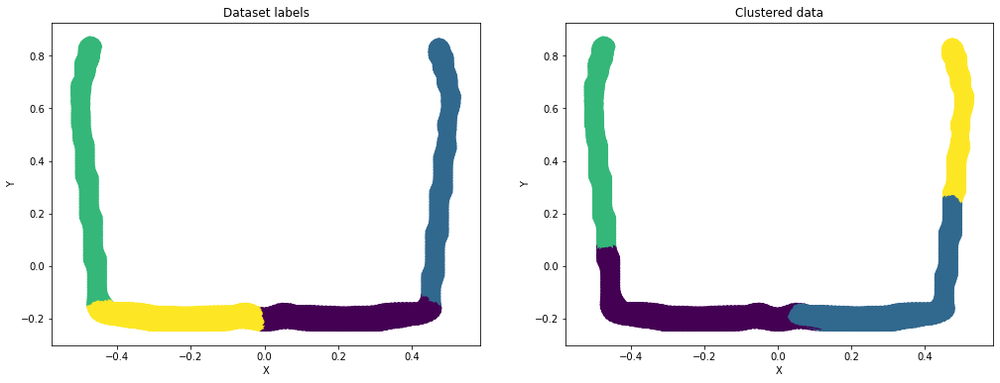

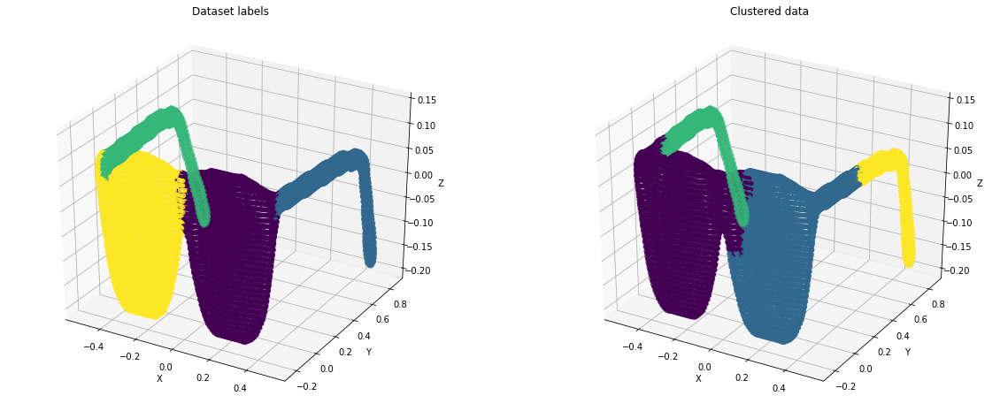

adjusted_rand_score:		 0.6607013513017364
adjusted_mutual_info_score:	 0.6822286952600237
homogeneity_score:		 0.682373560528518
completeness_score:		 0.7314836535028068
v_measure_score:		 0.7060756915981761
fowlkes_mallows_score:		 0.7631976163623657
silhouette_score:		 0.5291469522698843

Average score:			 0.6793153601176444
----------------------------------------------------------------------------------------------------

Category: Airplane
--------------------
CPU times: user 1.41 s, sys: 198 ms, total: 1.61 s
Wall time: 1.49 s


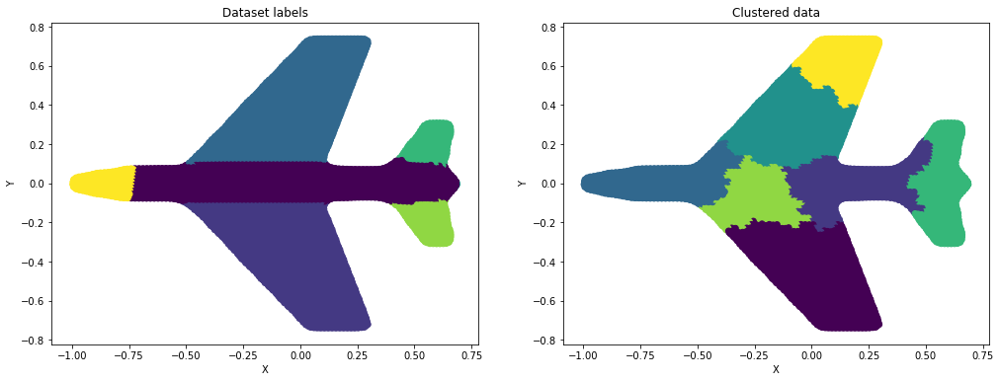

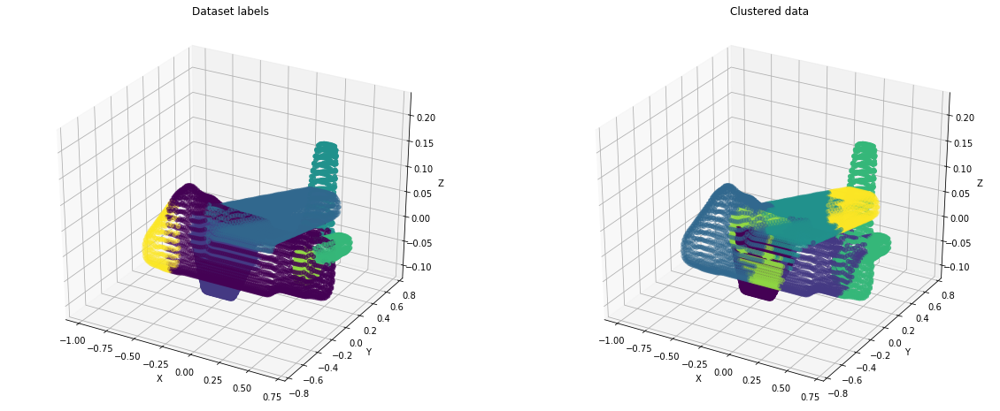

adjusted_rand_score:		 0.4680249370325227
adjusted_mutual_info_score:	 0.5449048181202721
homogeneity_score:		 0.6493517187282529
completeness_score:		 0.545462804925681
v_measure_score:		 0.5928907003869236
fowlkes_mallows_score:		 0.58095492243675
silhouette_score:		 0.3411988432687847

Average score:			 0.5318269635570267
----------------------------------------------------------------------------------------------------

Category: Ant
--------------------
CPU times: user 1.49 s, sys: 195 ms, total: 1.68 s
Wall time: 1.52 s


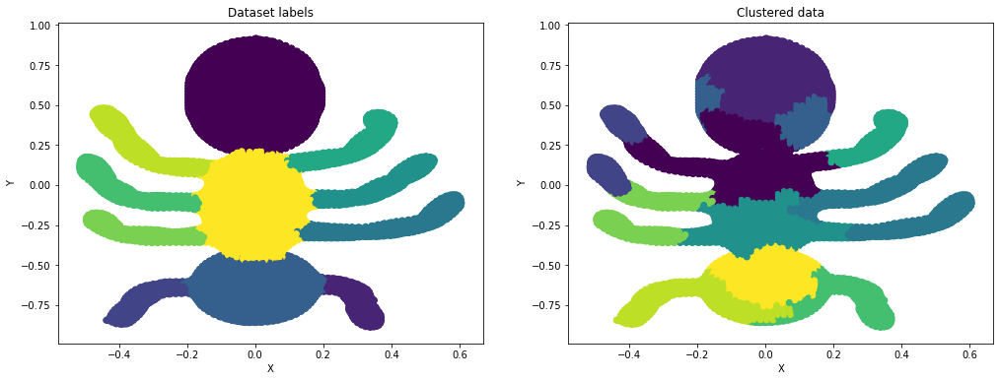

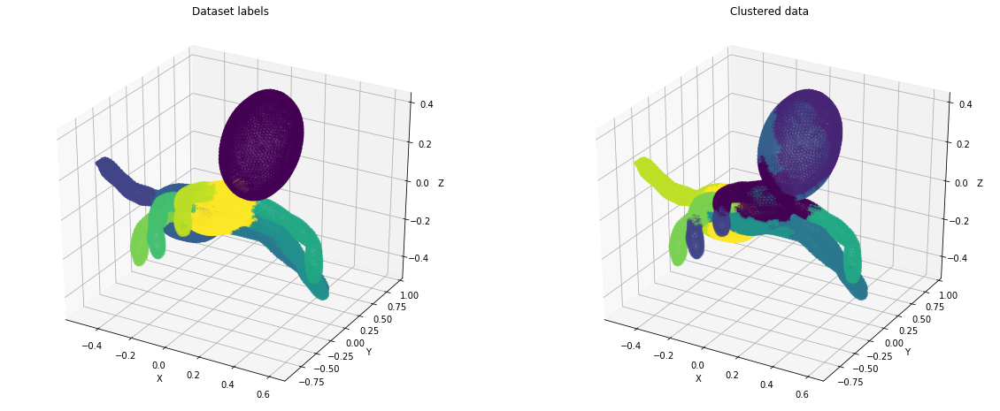

adjusted_rand_score:		 0.47371785885423917
adjusted_mutual_info_score:	 0.6777593794427988
homogeneity_score:		 0.7349602202805634
completeness_score:		 0.6786381319855777
v_measure_score:		 0.7056771538751841
fowlkes_mallows_score:		 0.5455405829540616
silhouette_score:		 0.2823479174744075

Average score:			 0.5855201778381189
----------------------------------------------------------------------------------------------------

Category: Chair
--------------------
CPU times: user 1.97 s, sys: 250 ms, total: 2.22 s
Wall time: 2.02 s


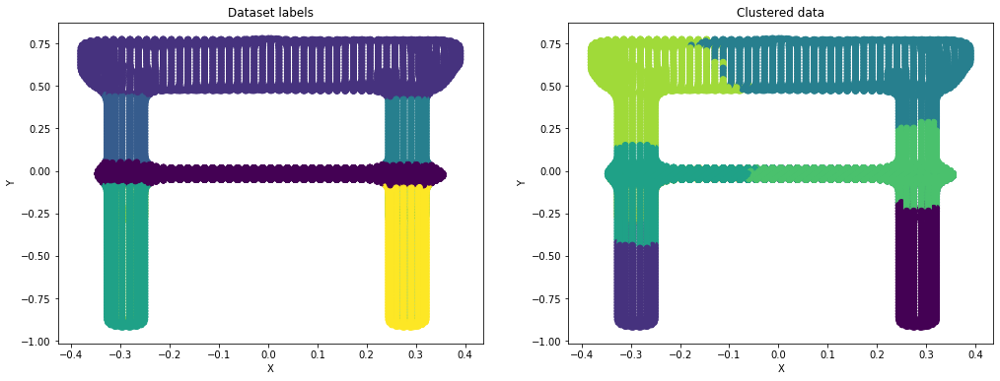

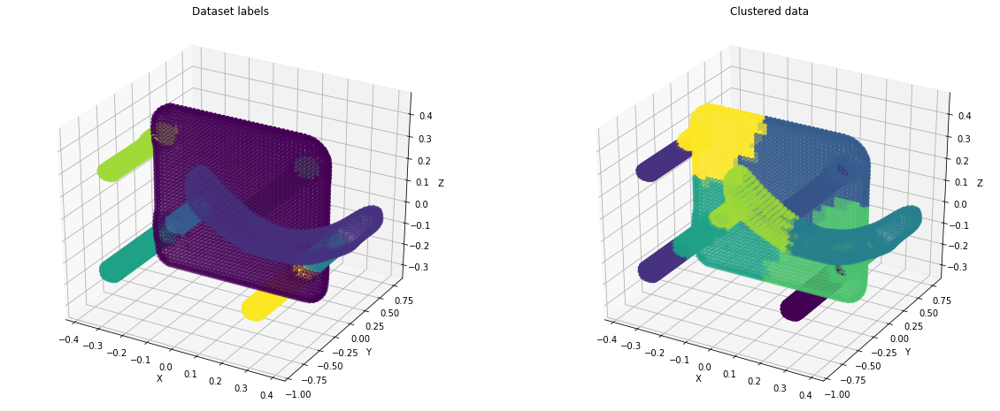

adjusted_rand_score:		 0.36938447694003396
adjusted_mutual_info_score:	 0.5666672875589316
homogeneity_score:		 0.6759652223453146
completeness_score:		 0.5671779217823254
v_measure_score:		 0.616811590552565
fowlkes_mallows_score:		 0.4957212290135962
silhouette_score:		 0.3542360468317089

Average score:			 0.5208519678606394
----------------------------------------------------------------------------------------------------

Category: Octopus
--------------------
CPU times: user 2.56 s, sys: 323 ms, total: 2.88 s
Wall time: 2.56 s


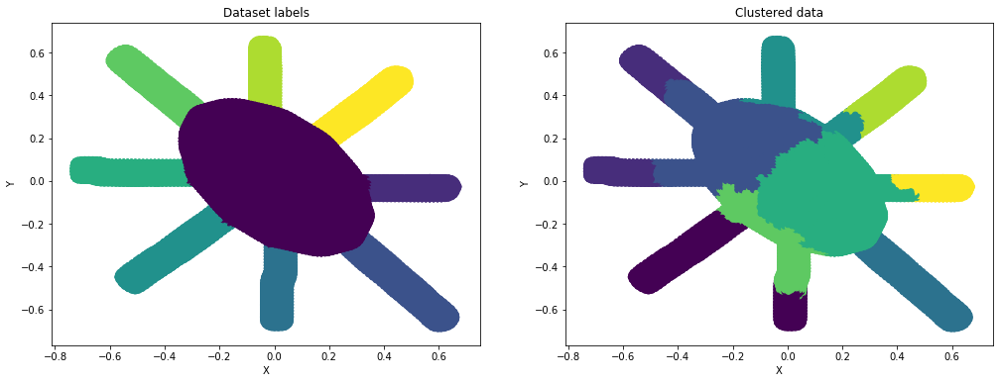

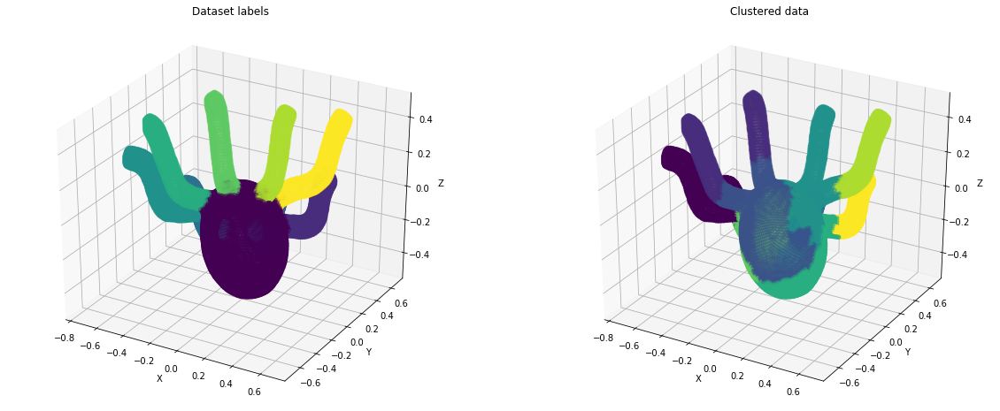

adjusted_rand_score:		 0.3691041734389585
adjusted_mutual_info_score:	 0.6308838102315997
homogeneity_score:		 0.7077709730083321
completeness_score:		 0.6312738757949992
v_measure_score:		 0.667337357229608
fowlkes_mallows_score:		 0.4820093532497409
silhouette_score:		 0.3103841691941562

Average score:			 0.5426805303067705
----------------------------------------------------------------------------------------------------

Category: Table
--------------------
CPU times: user 1.59 s, sys: 166 ms, total: 1.76 s
Wall time: 1.51 s


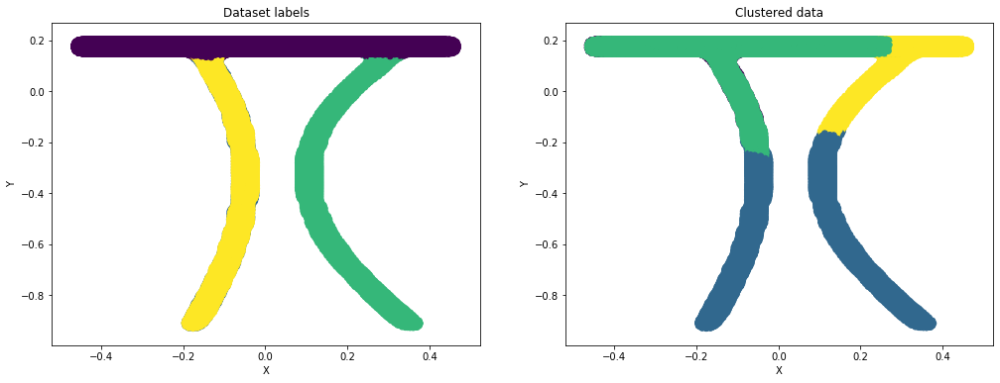

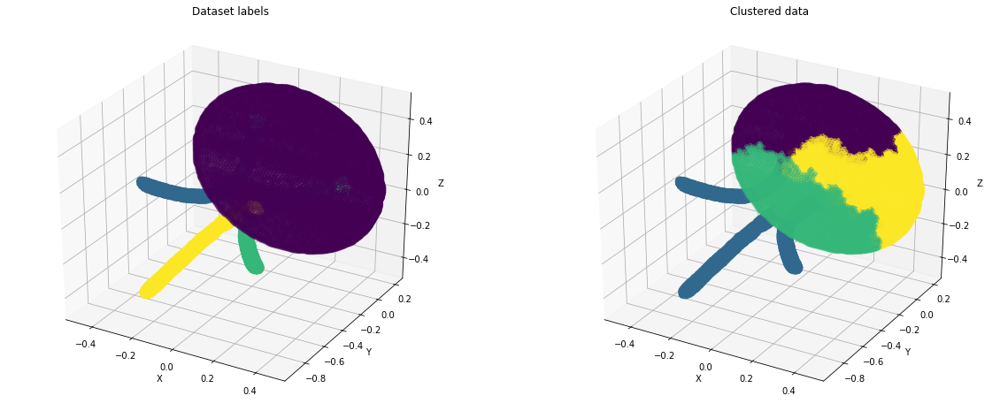

adjusted_rand_score:		 0.19677000628486244
adjusted_mutual_info_score:	 0.3142156783365725
homogeneity_score:		 0.4556507886331295
completeness_score:		 0.31438029374819376
v_measure_score:		 0.3720567443435809
fowlkes_mallows_score:		 0.4979766492145627
silhouette_score:		 0.34074463374062675

Average score:			 0.3559706849002184
----------------------------------------------------------------------------------------------------

Category: Teddy
--------------------
CPU times: user 2.97 s, sys: 444 ms, total: 3.41 s
Wall time: 3.03 s


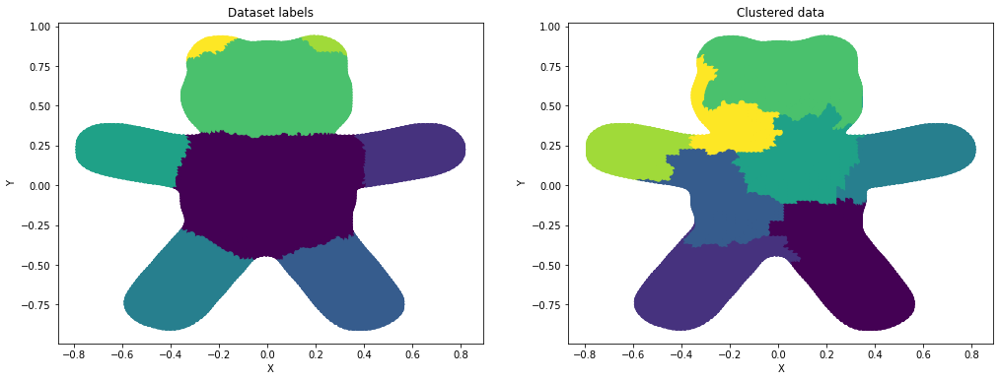

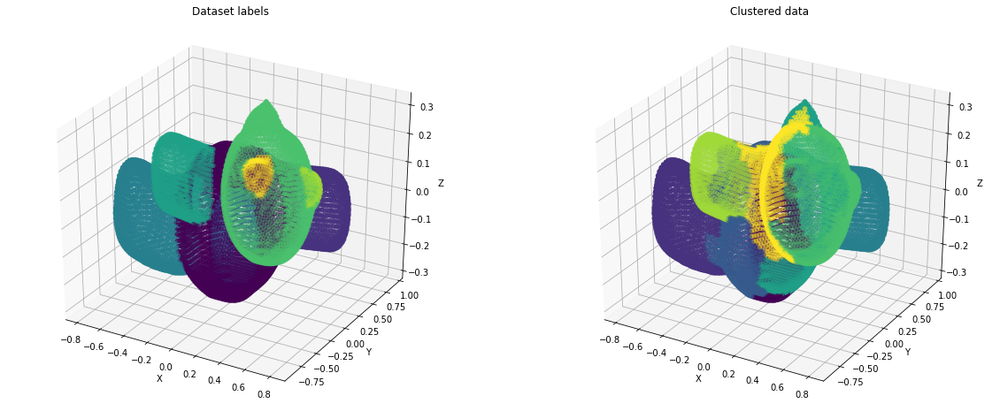

adjusted_rand_score:		 0.46945650710075904
adjusted_mutual_info_score:	 0.6107136068434448
homogeneity_score:		 0.6929784610966926
completeness_score:		 0.6110878317209479
v_measure_score:		 0.6494619292795645
fowlkes_mallows_score:		 0.560083277781099
silhouette_score:		 0.3001692839753736

Average score:			 0.5562786996854117
----------------------------------------------------------------------------------------------------

Category: Hand
--------------------
CPU times: user 3.25 s, sys: 481 ms, total: 3.73 s
Wall time: 3.29 s


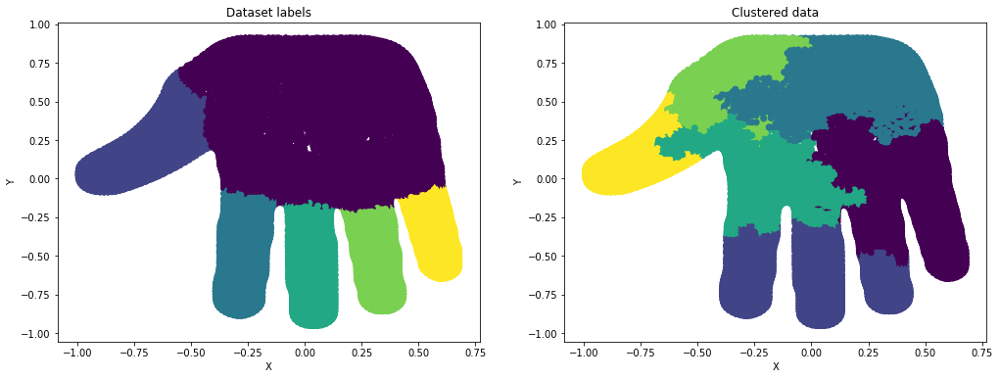

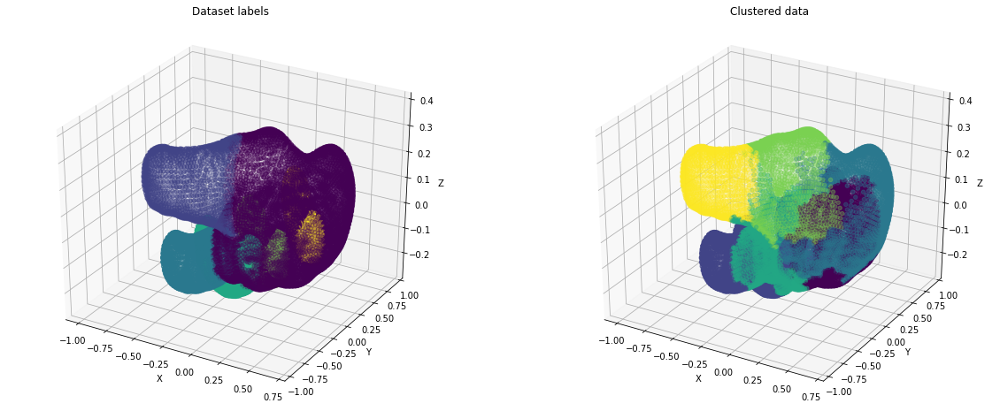

adjusted_rand_score:		 0.26061833060346495
adjusted_mutual_info_score:	 0.4808570874945043
homogeneity_score:		 0.5278765843457699
completeness_score:		 0.48118837586608754
v_measure_score:		 0.5034523767939553
fowlkes_mallows_score:		 0.43054690232120574
silhouette_score:		 0.3201812742751736

Average score:			 0.42924584738573734
----------------------------------------------------------------------------------------------------

Category: Plier
--------------------
CPU times: user 507 ms, sys: 44.3 ms, total: 551 ms
Wall time: 490 ms


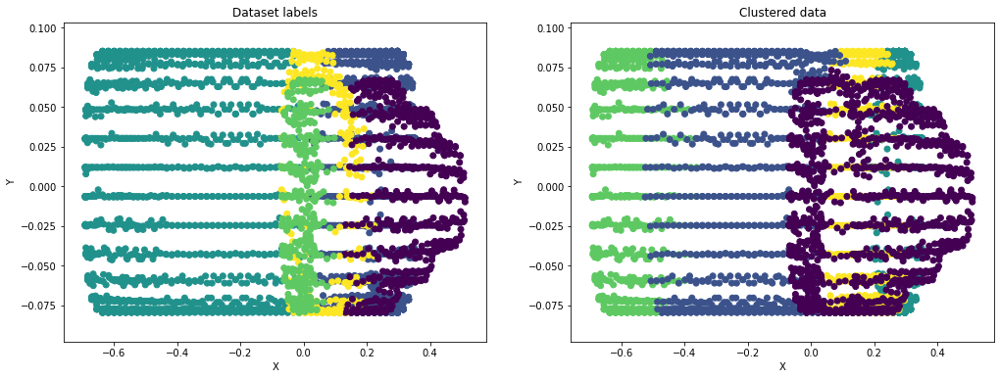

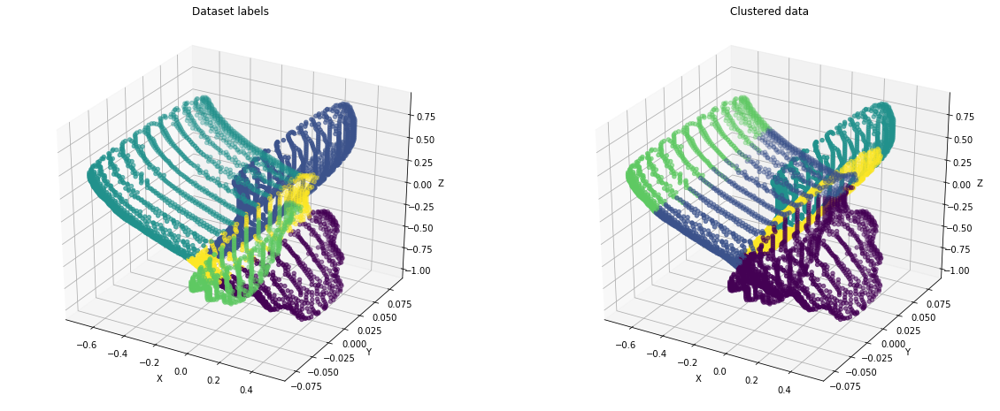

adjusted_rand_score:		 0.4661340542175681
adjusted_mutual_info_score:	 0.6573721480578261
homogeneity_score:		 0.6690584634704277
completeness_score:		 0.6577719102291403
v_measure_score:		 0.663367182867288
fowlkes_mallows_score:		 0.5935319655821755
silhouette_score:		 0.4263715999889514

Average score:			 0.5905153320590538
----------------------------------------------------------------------------------------------------

Category: Fish
--------------------
CPU times: user 781 ms, sys: 74 ms, total: 855 ms
Wall time: 675 ms


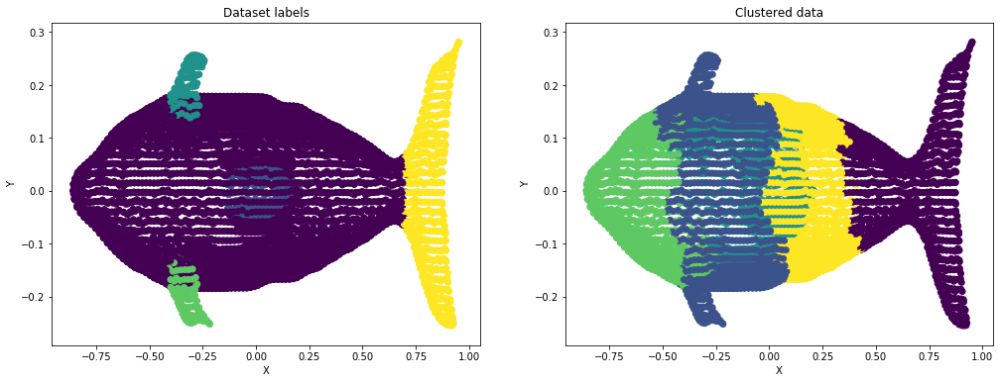

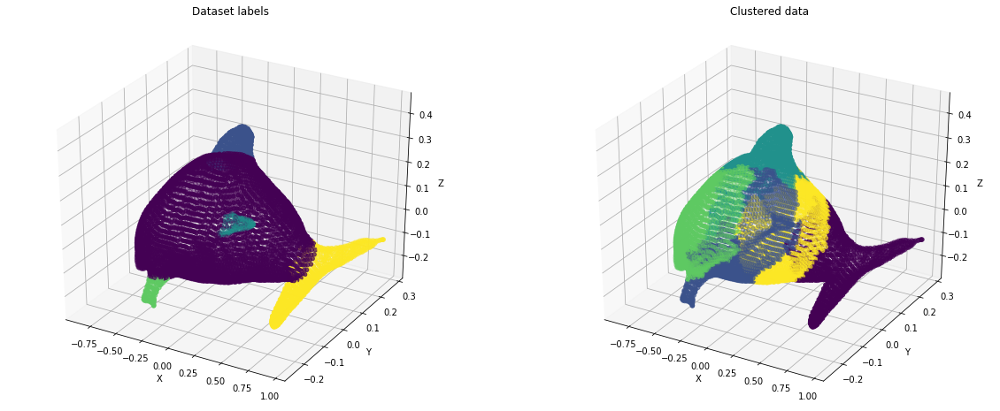

adjusted_rand_score:		 0.06443357805497246
adjusted_mutual_info_score:	 0.21443306554944705
homogeneity_score:		 0.46891648775339495
completeness_score:		 0.21518435876291536
v_measure_score:		 0.29499596220180097
fowlkes_mallows_score:		 0.41557614693980527
silhouette_score:		 0.31073681075817283

Average score:			 0.2834680585743584
----------------------------------------------------------------------------------------------------

Category: Bird
--------------------
CPU times: user 1.51 s, sys: 177 ms, total: 1.69 s
Wall time: 1.43 s


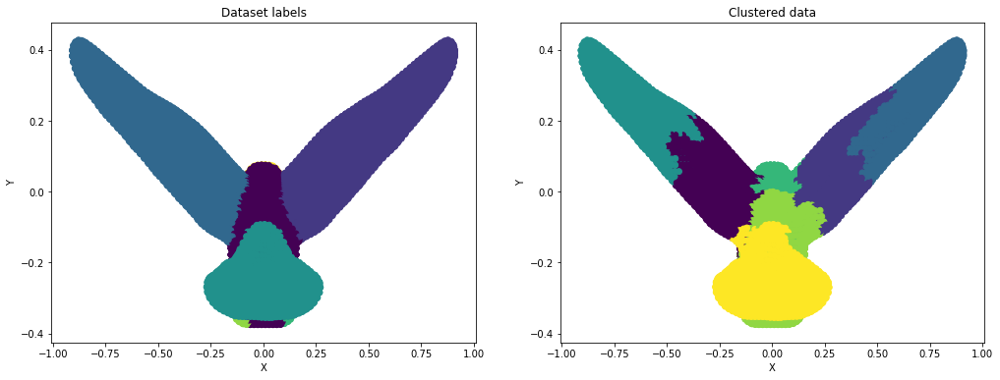

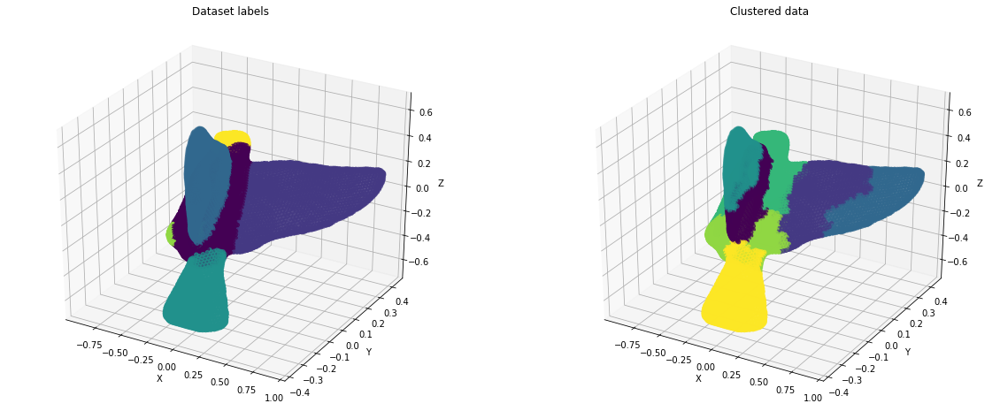

adjusted_rand_score:		 0.540005221089886
adjusted_mutual_info_score:	 0.6110211807585236
homogeneity_score:		 0.7830007308649244
completeness_score:		 0.6114882518104916
v_measure_score:		 0.6866970682899619
fowlkes_mallows_score:		 0.6433474312572507
silhouette_score:		 0.3353804760111752

Average score:			 0.6015629085831734
----------------------------------------------------------------------------------------------------

Category: Armadillo
--------------------
CPU times: user 5.24 s, sys: 825 ms, total: 6.06 s
Wall time: 5.43 s


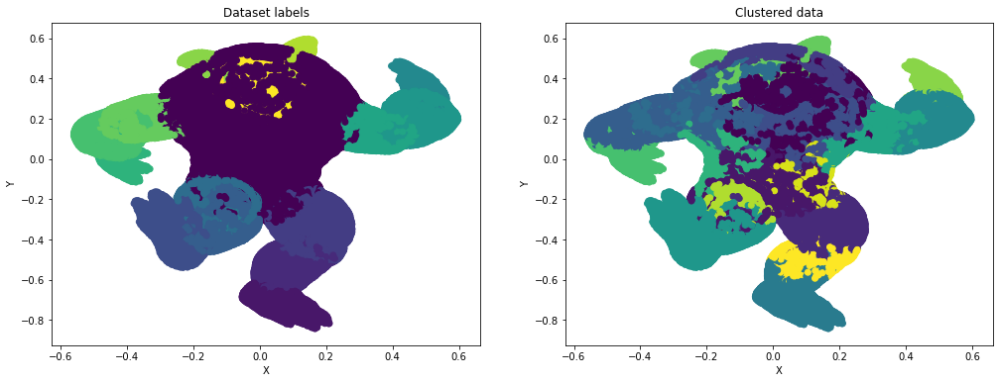

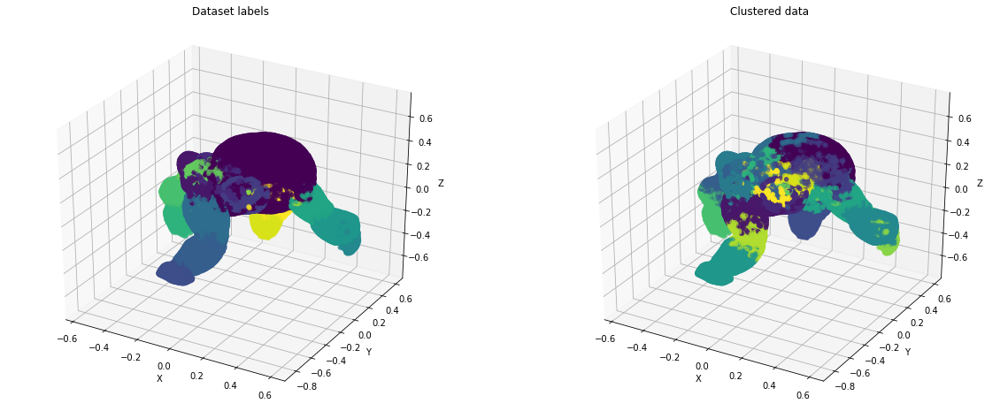

adjusted_rand_score:		 0.2623553789890065
adjusted_mutual_info_score:	 0.6221276342458599
homogeneity_score:		 0.7247257926648609
completeness_score:		 0.6228871655760737
v_measure_score:		 0.6699585248900232
fowlkes_mallows_score:		 0.3604773407220946
silhouette_score:		 0.2560404210702347

Average score:			 0.5026531797368791
----------------------------------------------------------------------------------------------------

Category: Bust
--------------------
CPU times: user 2.77 s, sys: 392 ms, total: 3.16 s
Wall time: 2.97 s


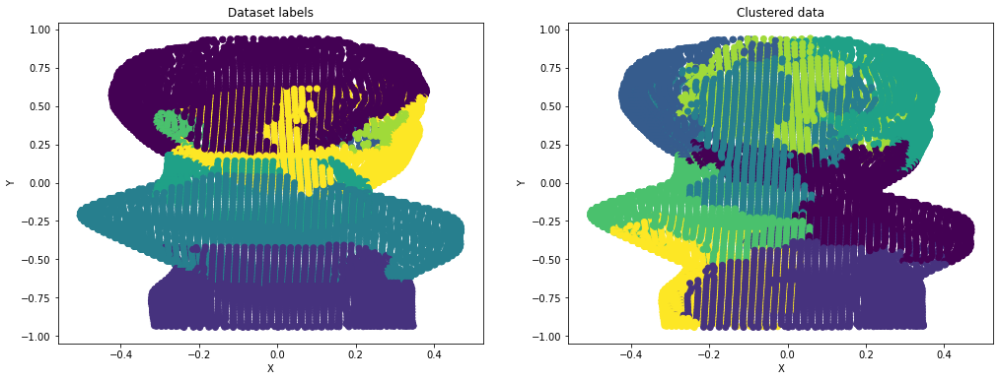

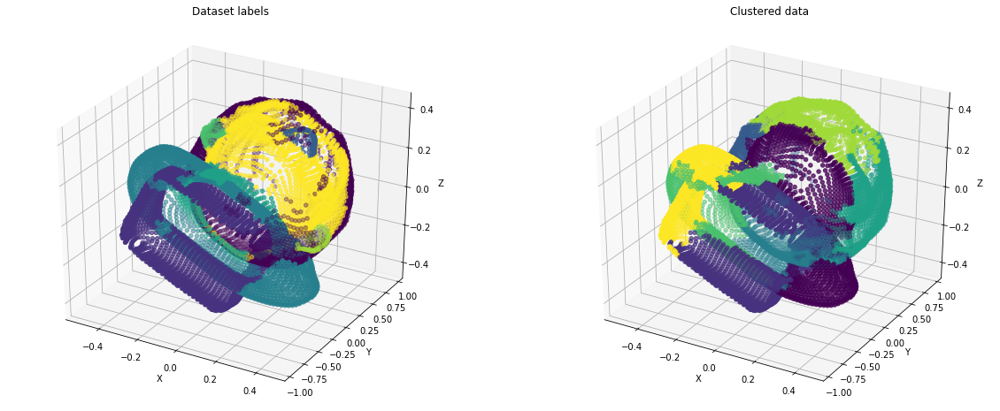

adjusted_rand_score:		 0.2723934719419331
adjusted_mutual_info_score:	 0.4053115475303292
homogeneity_score:		 0.5058865308065389
completeness_score:		 0.40608340762544654
v_measure_score:		 0.4505238991867402
fowlkes_mallows_score:		 0.40309505379640653
silhouette_score:		 0.24257459175214505

Average score:			 0.383695500377077
----------------------------------------------------------------------------------------------------

Category: Mech
--------------------
CPU times: user 5.98 s, sys: 906 ms, total: 6.88 s
Wall time: 6.47 s


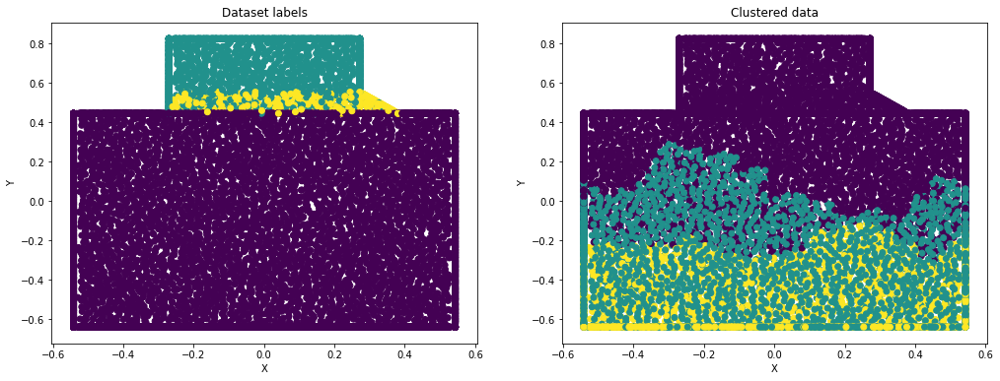

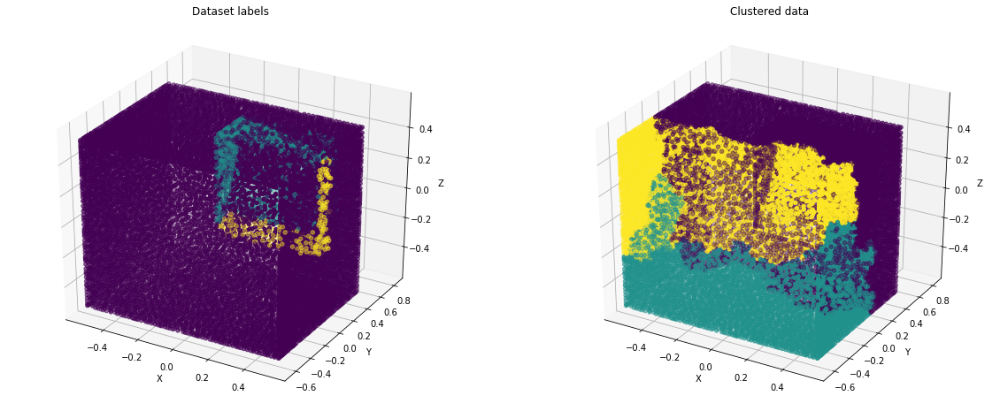

adjusted_rand_score:		 -0.061152020711598254
adjusted_mutual_info_score:	 0.1097207537556282
homogeneity_score:		 0.2222470056020106
completeness_score:		 0.1098389842022646
v_measure_score:		 0.14701845959660892
fowlkes_mallows_score:		 0.5079558805864062
silhouette_score:		 0.25649589617496626

Average score:			 0.1845892798866124
----------------------------------------------------------------------------------------------------

Category: Bearing
--------------------
CPU times: user 2.49 s, sys: 364 ms, total: 2.85 s
Wall time: 2.51 s


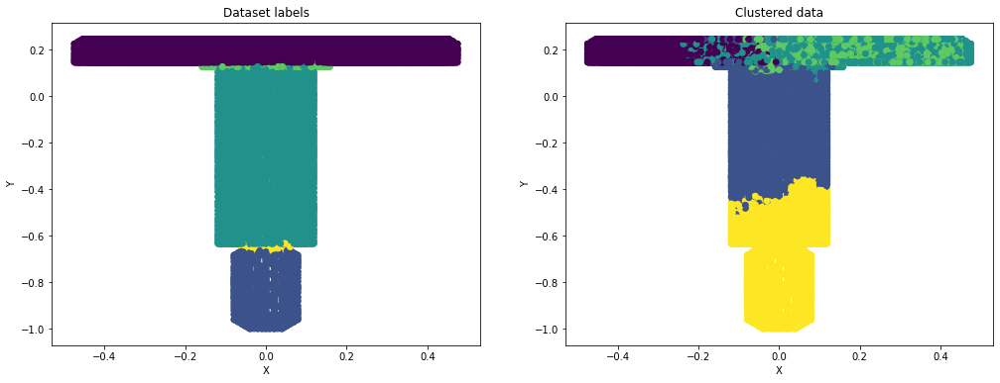

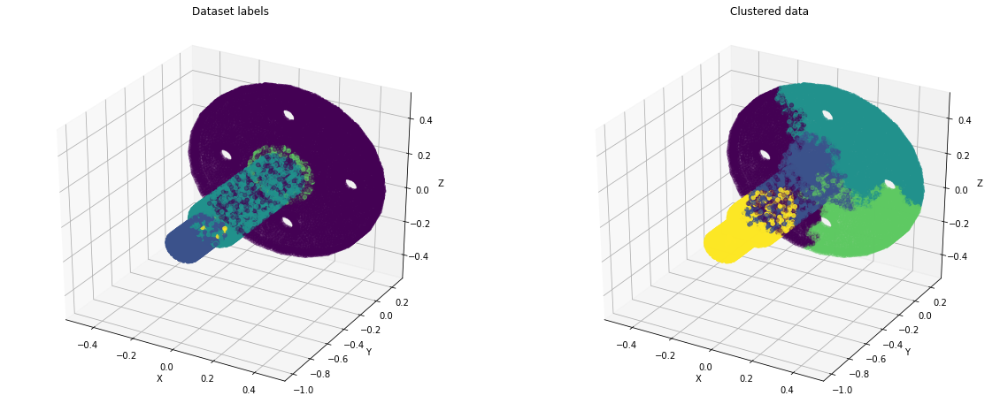

adjusted_rand_score:		 0.28278584744280566
adjusted_mutual_info_score:	 0.3760878181734319
homogeneity_score:		 0.65160837725724
completeness_score:		 0.37631062397790604
v_measure_score:		 0.47709431334621155
fowlkes_mallows_score:		 0.539358205636264
silhouette_score:		 0.3327444030689367

Average score:			 0.4337127984146851
----------------------------------------------------------------------------------------------------

Category: Vase
--------------------
CPU times: user 1.89 s, sys: 236 ms, total: 2.12 s
Wall time: 1.83 s


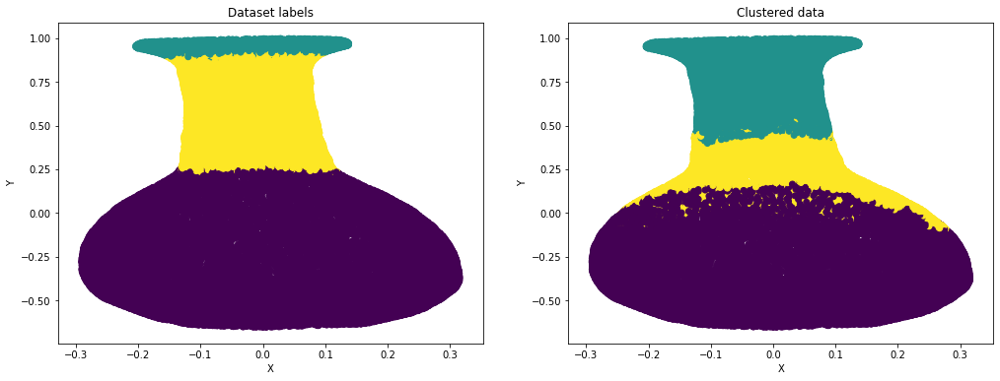

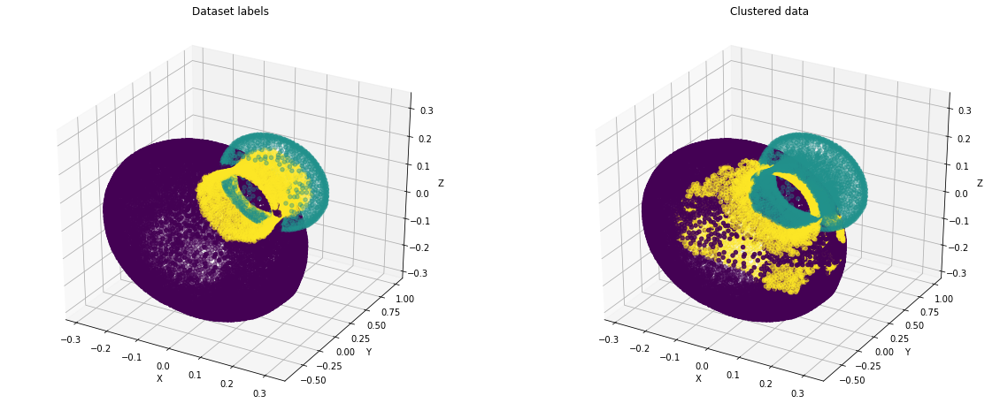

adjusted_rand_score:		 0.6114425194733647
adjusted_mutual_info_score:	 0.528915408730865
homogeneity_score:		 0.6535105567413432
completeness_score:		 0.528989378931301
v_measure_score:		 0.584693720662245
fowlkes_mallows_score:		 0.8093384388365782
silhouette_score:		 0.3566668539278079

Average score:			 0.5819366967576436
----------------------------------------------------------------------------------------------------

Category: Fourleg
--------------------
CPU times: user 2.44 s, sys: 377 ms, total: 2.82 s
Wall time: 2.54 s


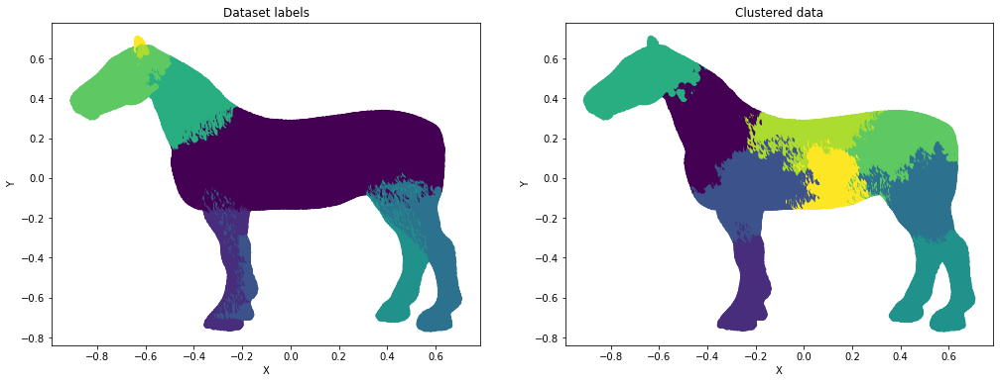

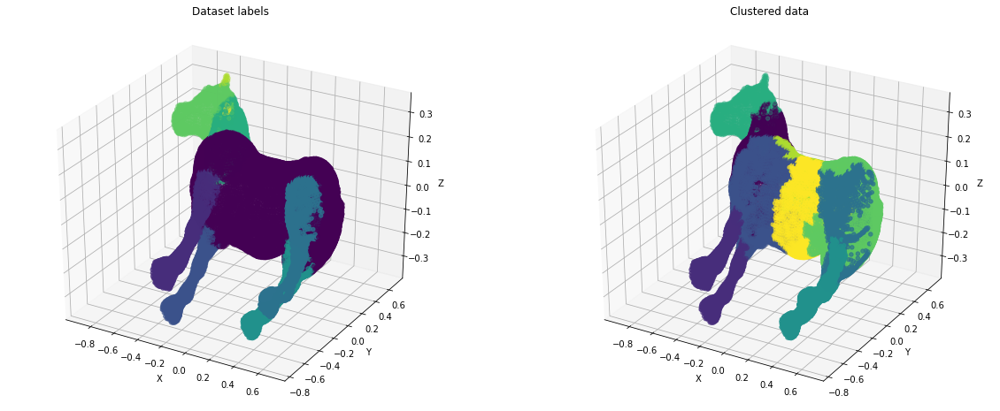

adjusted_rand_score:		 0.20931387427654408
adjusted_mutual_info_score:	 0.46367333890851126
homogeneity_score:		 0.6295194632053984
completeness_score:		 0.46423122348546
v_measure_score:		 0.5343861158998341
fowlkes_mallows_score:		 0.37930737746071036
silhouette_score:		 0.3021421900282773

Average score:			 0.42608194046639086
----------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------

Average score per category: 0.48837755691509155


In [24]:
scores = []
for i in range(len(models)):
    print(f'\nCategory: {models[i][1]}')
    print('-' * 20)
    
    %time cluster = clust.Birch(n_clusters=len(np.unique(data_labels[i])), threshold=0.01).fit(meshes[i])
    pred_labels = cluster.labels_

    plot_data(meshes[i], data_labels[i], pred_labels)
    scores.append(eval_scores(meshes[i], data_labels[i], pred_labels))
    
print('-' * 100)
print(f'\nAverage score per category: {np.average(scores)}')